## Download Data

In [ ]:
# Khoa_LHR_image.zip
!gdown --id 1qTkTp1OfumLB2dHtX6e_c2lhNNcnOZOx



In [ ]:
!pip install torcheval


In [ ]:
!unzip /content/Khoa_LHR_image.zip

In [ ]:
import torch
from torch import nn
from torch.utils.data import Dataset, DataLoader
from torch import optim
from PIL import Image
from torchvision import transforms
import os
import matplotlib.pyplot as plt
import numpy as np
from torcheval.metrics.functional import peak_signal_noise_ratio
device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')
torch.manual_seed(66)


## Problem 2: Super Resolution with UNET

In [ ]:
LHR_TRAIN_DATA_PATH = '/content/Khoa_LHR_image/train'
LHR_VAL_DATA_PATH = '/content/Khoa_LHR_image/val'
BATCH_SIZE = 32
LOW_IMG_HEIGHT = 64
LOW_IMG_WIDTH = 64

### Unet for Super Resolution Task

#### No skip connection

In [ ]:
class FirstFeatureNoSkip(nn.Module):
    def __init__(self, in_channels, out_channels):
        super(FirstFeatureNoSkip, self).__init__()
        self.conv = nn.Sequential(
            nn.Conv2d(in_channels, out_channels, 1, 1, 0, bias=False),
            nn.LeakyReLU()
        )

    def forward(self, x):
        return self.conv(x)


class ConvBlockNoSkip(nn.Module):
    def __init__(self, in_channels, out_channels):
        super(ConvBlockNoSkip, self).__init__()
        self.conv = nn.Sequential(
            nn.Conv2d(in_channels, out_channels, 3, 1, 1, bias=False),
            nn.BatchNorm2d(out_channels),
            nn.LeakyReLU(inplace=True),
            nn.Conv2d(out_channels, out_channels, 3, 1, 1, bias=False),
            nn.BatchNorm2d(out_channels),
            nn.LeakyReLU(inplace=True),
        )

    def forward(self, x):
        return self.conv(x)


class EncoderNoSkip(nn.Module):
    def __init__(self, in_channels, out_channels) -> None:
        super(EncoderNoSkip, self).__init__()
        self.encoder = nn.Sequential(
            nn.MaxPool2d(2),
            ConvBlockNoSkip(in_channels, out_channels)
        )

    def forward(self, x):
        x = self.encoder(x)
        return x


class DecoderNoSkip(nn.Module):
    def __init__(self, in_channels, out_channels):
        super(DecoderNoSkip, self).__init__()
        self.conv = nn.Sequential(
            nn.UpsamplingBilinear2d(scale_factor=2),
            nn.Conv2d(in_channels, out_channels*2, 1, 1, 0, bias=False),
            nn.BatchNorm2d(out_channels*2),
            nn.LeakyReLU(),
        )
        self.conv_block = ConvBlockNoSkip(out_channels*2, out_channels)

    def forward(self, x):
        x = self.conv(x)
        x = self.conv_block(x)
        return x


class FinalOutputNoSkip(nn.Module):
    def __init__(self, in_channels, out_channels):
        super(FinalOutputNoSkip, self).__init__()
        self.conv = nn.Sequential(
            nn.Conv2d(in_channels, out_channels, 1, 1, 0, bias=False),
            nn.Tanh()
        )

    def forward(self, x):
        return self.conv(x)


class SR_Unet_NoSkip(nn.Module):
    def __init__(
            self, n_channels=3, n_classes=3
    ):
        super(SR_Unet_NoSkip, self).__init__()

        self.n_channels = n_channels
        self.n_classes = n_classes
        self.resize_fnc = transforms.Resize((LOW_IMG_HEIGHT*4, LOW_IMG_HEIGHT*4),
                                             antialias=True)
        self.in_conv1 = FirstFeatureNoSkip(n_channels, 64)
        self.in_conv2 = ConvBlockNoSkip(64, 64)

        self.enc_1 = EncoderNoSkip(64, 128)
        self.enc_2 = EncoderNoSkip(128, 256)
        self.enc_3 = EncoderNoSkip(256, 512)
        self.enc_4 = EncoderNoSkip(512, 1024)

        self.dec_1 = DecoderNoSkip(1024, 512)
        self.dec_2 = DecoderNoSkip(512, 256)
        self.dec_3 = DecoderNoSkip(256, 128)
        self.dec_4 = DecoderNoSkip(128, 64)

        self.out_conv = FinalOutputNoSkip(64, n_classes)


    def forward(self, x):
        x = self.resize_fnc(x)
        x = self.in_conv1(x)
        x = self.in_conv2(x)

        x = self.enc_1(x)
        x = self.enc_2(x)
        x = self.enc_3(x)
        x = self.enc_4(x)

        x = self.dec_1(x)
        x = self.dec_2(x)
        x = self.dec_3(x)
        x = self.dec_4(x)

        x = self.out_conv(x)
        return x

In [ ]:
unet_model = SR_Unet_NoSkip().to(device)
img = torch.ones(2, 3, 64, 64).to(device)
unet_model(img).shape

torch.Size([2, 3, 256, 256])

#### Skip connection

In [ ]:
class FirstFeature(nn.Module):
    def __init__(self, in_channels, out_channels):
        super(FirstFeature, self).__init__()
        self.conv = nn.Sequential(
            nn.Conv2d(in_channels, out_channels, 1, 1, 0, bias=False),
            nn.LeakyReLU()
        )

    def forward(self, x):
        return self.conv(x)


class ConvBlock(nn.Module):
    def __init__(self, in_channels, out_channels):
        super(ConvBlock, self).__init__()
        self.conv = nn.Sequential(
            nn.Conv2d(in_channels, out_channels, 3, 1, 1, bias=False),
            nn.BatchNorm2d(out_channels),
            nn.LeakyReLU(inplace=True),
            nn.Conv2d(out_channels, out_channels, 3, 1, 1, bias=False),
            nn.BatchNorm2d(out_channels),
            nn.LeakyReLU(inplace=True),
        )

    def forward(self, x):
        return self.conv(x)


class Encoder(nn.Module):
    def __init__(self, in_channels, out_channels) -> None:
        super().__init__()
        self.encoder = nn.Sequential(
            nn.MaxPool2d(2),
            ConvBlock(in_channels, out_channels)
        )

    def forward(self, x):
        x = self.encoder(x)
        return x


class Decoder(nn.Module):
    def __init__(self, in_channels, out_channels):
        super(Decoder, self).__init__()
        self.conv = nn.Sequential(
            nn.UpsamplingBilinear2d(scale_factor=2),
            nn.Conv2d(in_channels, out_channels, 1, 1, 0, bias=False),
            nn.BatchNorm2d(out_channels),
            nn.LeakyReLU(),
        )
        self.conv_block = ConvBlock(in_channels, out_channels)

    def forward(self, x, skip):
        x = self.conv(x)
        x = torch.concat([x, skip], dim=1)
        x = self.conv_block(x)
        return x


class FinalOutput(nn.Module):
    def __init__(self, in_channels, out_channels):
        super(FinalOutput, self).__init__()
        self.conv = nn.Sequential(
            nn.Conv2d(in_channels, out_channels, 1, 1, 0, bias=False),
            nn.Tanh()
        )

    def forward(self, x):
        return self.conv(x)


class SR_Unet(nn.Module):
    def __init__(
            self, n_channels=3, n_classes=3
    ):
        super(SR_Unet, self).__init__()

        self.n_channels = n_channels
        self.n_classes = n_classes
        self.resize_fnc = transforms.Resize((LOW_IMG_HEIGHT*4, LOW_IMG_HEIGHT*4),
                                             antialias=True)
        self.in_conv1 = FirstFeature(n_channels, 64)
        self.in_conv2 = ConvBlock(64, 64)

        self.enc_1 = Encoder(64, 128)
        self.enc_2 = Encoder(128, 256)
        self.enc_3 = Encoder(256, 512)
        self.enc_4 = Encoder(512, 1024)

        self.dec_1 = Decoder(1024, 512)
        self.dec_2 = Decoder(512, 256)
        self.dec_3 = Decoder(256, 128)
        self.dec_4 = Decoder(128, 64)

        self.out_conv = FinalOutput(64, n_classes)


    def forward(self, x):
        x = self.resize_fnc(x)
        x = self.in_conv1(x)
        x1 = self.in_conv2(x)

        x2 = self.enc_1(x1)
        x3 = self.enc_2(x2)
        x4 = self.enc_3(x3)
        x5 = self.enc_4(x4)

        x = self.dec_1(x5, x4)
        x = self.dec_2(x, x3)
        x = self.dec_3(x, x2)
        x = self.dec_4(x, x1)

        x = self.out_conv(x)
        return x

In [ ]:
unet_model = SR_Unet().to(device)
img = torch.ones(2, 3, 64, 64).to(device)
unet_model(img).shape

torch.Size([2, 3, 256, 256])

### Prepare Super Resolution Dataset

#### Split Tran Validation data

In [ ]:
class ImageDataset(Dataset):
    def __init__(self, img_dir, is_train=True):
        self.resize = transforms.Resize((LOW_IMG_WIDTH, LOW_IMG_HEIGHT), antialias=True)
        self.is_train = is_train
        self.img_dir = img_dir
        self.images = os.listdir(img_dir)

    def __len__(self):
        return len(self.images)

    def normalize(self, input_image, target_image):
        input_image  = input_image*2 - 1
        target_image = target_image*2 - 1

        return input_image, target_image

    def random_jitter(self, input_image, target_image):
        if torch.rand([]) < 0.5:
            input_image = transforms.functional.hflip(input_image)
            target_image = transforms.functional.hflip(target_image)

        return input_image, target_image

    def __getitem__(self, idx):
        img_path = os.path.join(self.img_dir, self.images[idx])
        image = np.array(Image.open(img_path).convert("RGB"))
        image = transforms.functional.to_tensor(image)

        input_image = self.resize(image).type(torch.float32)
        target_image = image.type(torch.float32)

        input_image, target_image = self.normalize(input_image, target_image)

        if self.is_train:
            input_image, target_image = self.random_jitter(input_image, target_image)

        return input_image, target_image





In [ ]:
train_dataset = ImageDataset(LHR_TRAIN_DATA_PATH, is_train=True)
train_loader = DataLoader(train_dataset, batch_size=BATCH_SIZE, shuffle=True)

test_dataset = ImageDataset(LHR_VAL_DATA_PATH, is_train=False)
test_loader = DataLoader(test_dataset, batch_size=BATCH_SIZE, shuffle=False)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Text(0.5, 1.0, 'Target')

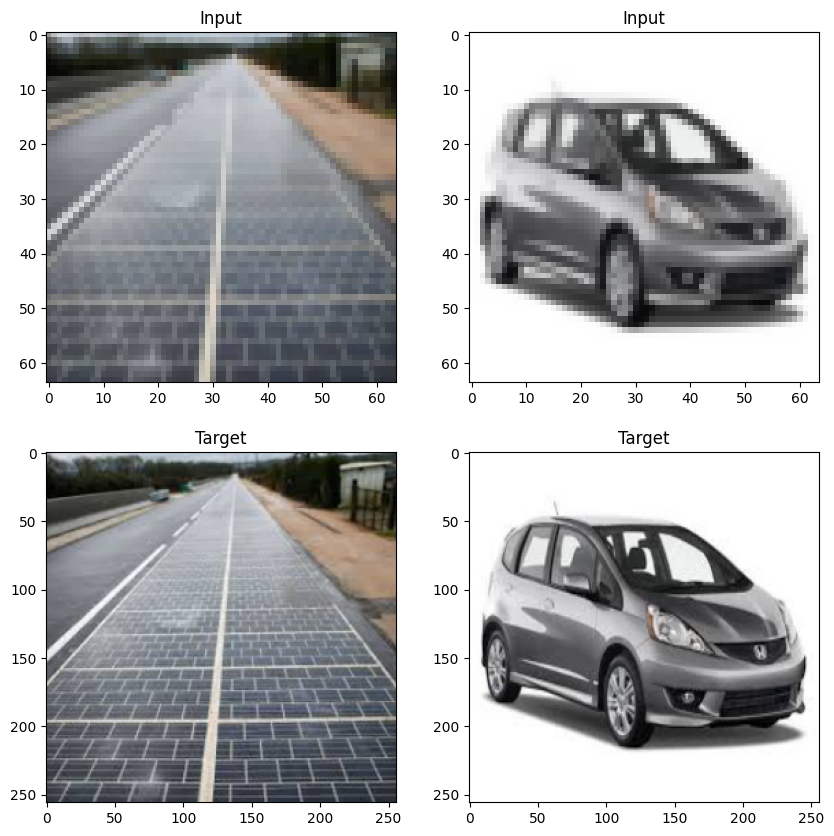

In [ ]:
in_batch, tar_batch = next(iter(train_loader))
in_batch = (in_batch + 1)/2
tar_batch = (tar_batch + 1)/2

plt.figure(figsize=(10, 10))
ax = plt.subplot(2, 2, 1)
plt.imshow(np.squeeze(in_batch[0].numpy().transpose((1, 2, 0))))
plt.title("Input")
ax = plt.subplot(2, 2, 3)
plt.imshow(np.squeeze(tar_batch[0].numpy().transpose((1, 2, 0))))
plt.title("Target")
ax = plt.subplot(2, 2, 2)
plt.imshow(np.squeeze(in_batch[1].numpy().transpose((1, 2, 0))))
plt.title("Input")
ax = plt.subplot(2, 2, 4)
plt.imshow(np.squeeze(tar_batch[1].numpy().transpose((1, 2, 0))))
plt.title("Target")



### Train

In [ ]:
def generate_images(model, inputs, labels):
    model.eval()
    with torch.no_grad():
        inputs, labels = inputs.to(device), labels.to(device)
        predictions = model(inputs)
    inputs, labels, predictions = inputs.cpu().numpy(), labels.cpu().numpy(), predictions.cpu().numpy()
    plt.figure(figsize=(15,20))

    display_list = [inputs[-1].transpose((1, 2, 0)), labels[-1].transpose((1, 2, 0)), predictions[-1].transpose((1, 2, 0))]
    title = ['Input', 'Real', 'Predicted']

    for i in range(3):
        plt.subplot(1, 3, i+1)
        plt.title(title[i])
        plt.imshow((display_list[i] + 1) / 2)
        plt.axis('off')
    plt.show()

In [ ]:
import time

def train_epoch(model, optimizer, criterion, train_dataloader, device, epoch=0,
                log_interval=50):
    model.train()
    total_psnr, total_count = 0, 0
    losses = []
    start_time = time.time()

    for idx, (inputs, labels) in enumerate(train_dataloader):
        inputs = inputs.to(device)
        labels = labels.to(device)

        optimizer.zero_grad()

        predictions = model(inputs)

        # compute loss
        loss = criterion(predictions, labels)
        losses.append(loss.item())

        # backward
        loss.backward()
        optimizer.step()

        total_psnr += peak_signal_noise_ratio(predictions, labels)
        total_count += 1
        if idx % log_interval == 0 and idx > 0:
            elapsed = time.time() - start_time
            print(
                "| epoch {:3d} | {:5d}/{:5d} batches "
                "| psnr {:8.3f}".format(
                    epoch, idx, len(train_dataloader), total_psnr / total_count
                )
            )
            total_psnr, total_count = 0, 0
            start_time = time.time()

    epoch_psnr = total_psnr / total_count
    epoch_loss = sum(losses) / len(losses)
    return epoch_psnr, epoch_loss

In [ ]:
def evaluate_epoch(model, criterion, valid_dataloader, device):
    model.eval()
    total_psnr, total_count = 0, 0
    losses = []

    with torch.no_grad():
        for idx, (inputs, labels) in enumerate(valid_dataloader):
            inputs = inputs.to(device)
            labels = labels.to(device)

            predictions = model(inputs)

            loss = criterion(predictions, labels)
            losses.append(loss.item())


            total_psnr +=  peak_signal_noise_ratio(predictions, labels)
            total_count += 1

    epoch_psnr = total_psnr / total_count
    epoch_loss = sum(losses) / len(losses)
    return epoch_psnr, epoch_loss

In [ ]:
def train(model, model_name, save_model, optimizer, criterion, train_dataloader, valid_dataloader, num_epochs, device):
    train_psnrs, train_losses = [], []
    eval_psnrs, eval_losses = [], []
    best_psnr_eval = -1000
    times = []
    for epoch in range(1, num_epochs+1):
        epoch_start_time = time.time()
        # Training
        train_psnr, train_loss = train_epoch(model, optimizer, criterion, train_dataloader, device, epoch)
        train_psnrs.append(train_psnr.cpu())
        train_losses.append(train_loss)

        # Evaluation
        eval_psnr, eval_loss = evaluate_epoch(model, criterion, valid_dataloader, device)
        eval_psnrs.append(eval_psnr.cpu())
        eval_losses.append(eval_loss)

        # Save best model
        if best_psnr_eval < eval_psnr :
            torch.save(model.state_dict(), save_model + f'/{model_name}.pt')
            inputs_t, targets_t = next(iter(valid_dataloader))
            generate_images(model, inputs_t, targets_t)
            best_psnr_eval = eval_psnr
        times.append(time.time() - epoch_start_time)
        # Print loss, psnr end epoch
        print("-" * 59)
        print(
            "| End of epoch {:3d} | Time: {:5.2f}s | Train psnr {:8.3f} | Train Loss {:8.3f} "
            "| Valid psnr {:8.3f} | Valid Loss {:8.3f} ".format(
                epoch, time.time() - epoch_start_time, train_psnr, train_loss, eval_psnr, eval_loss
            )
        )
        print("-" * 59)

    # Load best model
    model.load_state_dict(torch.load(save_model + f'/{model_name}.pt'))
    model.eval()
    metrics = {
        'train_psnr': train_psnrs,
        'train_loss': train_losses,
        'valid_psnr': eval_psnrs,
        'valid_loss': eval_losses,
        'time': times
    }
    return model, metrics

In [ ]:
import matplotlib.pyplot as plt

def plot_result(num_epochs, train_psnrs, eval_psnrs, train_losses, eval_losses):
    epochs = list(range(num_epochs))
    fig, axs = plt.subplots(nrows = 1, ncols =2 , figsize = (12,6))
    axs[0].plot(epochs, train_psnrs, label = "Training")
    axs[0].plot(epochs, eval_psnrs, label = "Evaluation")
    axs[1].plot(epochs, train_losses, label = "Training")
    axs[1].plot(epochs, eval_losses, label = "Evaluation")
    axs[0].set_xlabel("Epochs")
    axs[1].set_xlabel("Epochs")
    axs[0].set_ylabel("PSNR")
    axs[1].set_ylabel("Loss")
    plt.legend()

In [ ]:
import matplotlib.pyplot as plt

def predict_and_display(model, test_dataloader, device):
    model.eval()

    with torch.no_grad():
        for idx, (inputs, labels) in enumerate(test_dataloader):
            if idx >= 10:
                break
            inputs = inputs.to(device)
            predictions = model(inputs)
            generate_images(model, inputs, labels)
            plt.show()


# Usage example:
# predict_and_display(model, test_dataloader, device)


#### Unet No Skip Connection


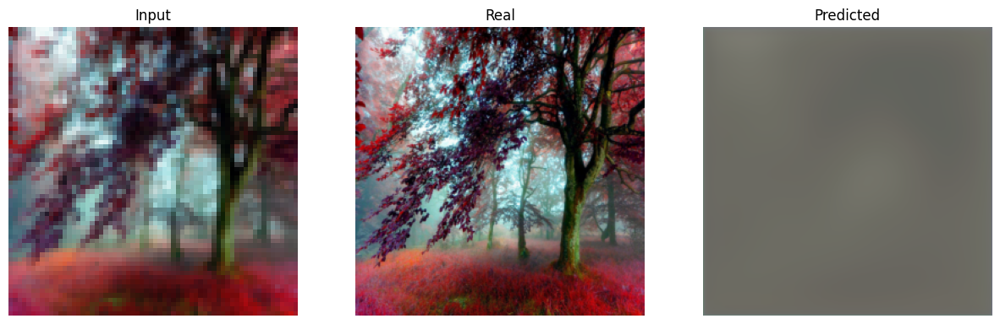

-----------------------------------------------------------
| End of epoch   1 | Time: 28.33s | Train psnr   14.878 | Train Loss    0.278 | Valid psnr   11.299 | Valid Loss    0.461 
-----------------------------------------------------------


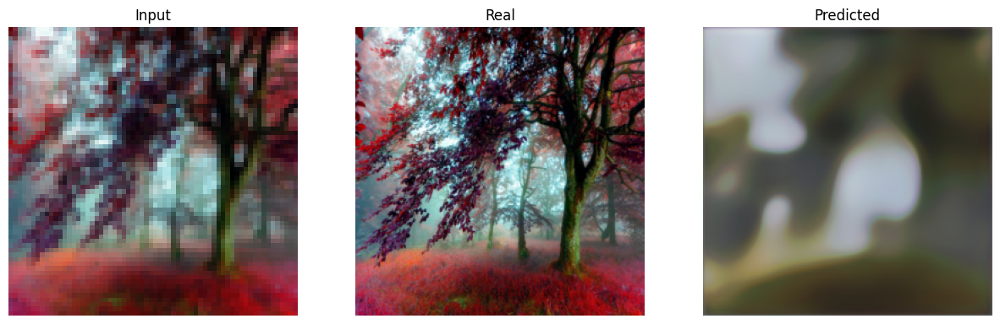

-----------------------------------------------------------
| End of epoch   2 | Time: 27.80s | Train psnr   17.012 | Train Loss    0.192 | Valid psnr   16.309 | Valid Loss    0.223 
-----------------------------------------------------------


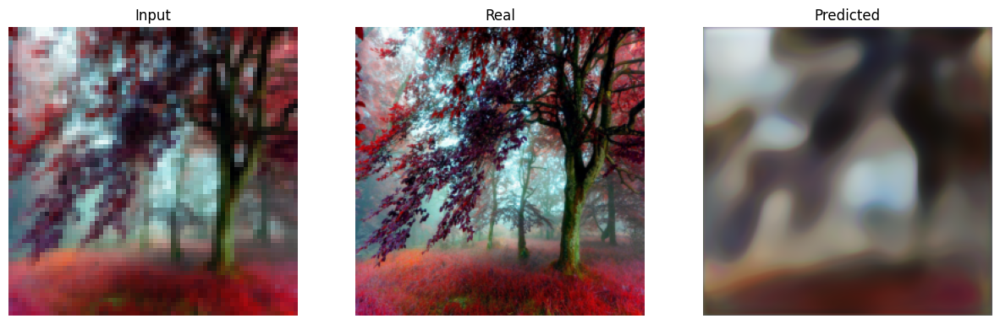

-----------------------------------------------------------
| End of epoch   3 | Time: 27.77s | Train psnr   17.304 | Train Loss    0.184 | Valid psnr   17.252 | Valid Loss    0.184 
-----------------------------------------------------------


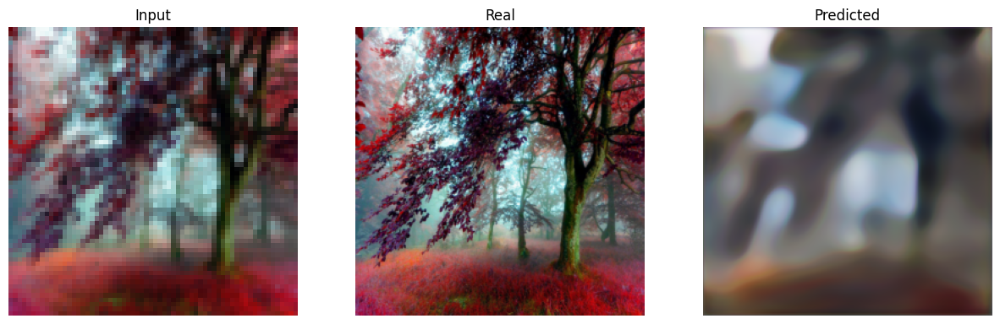

-----------------------------------------------------------
| End of epoch   4 | Time: 27.68s | Train psnr   17.672 | Train Loss    0.174 | Valid psnr   17.302 | Valid Loss    0.181 
-----------------------------------------------------------


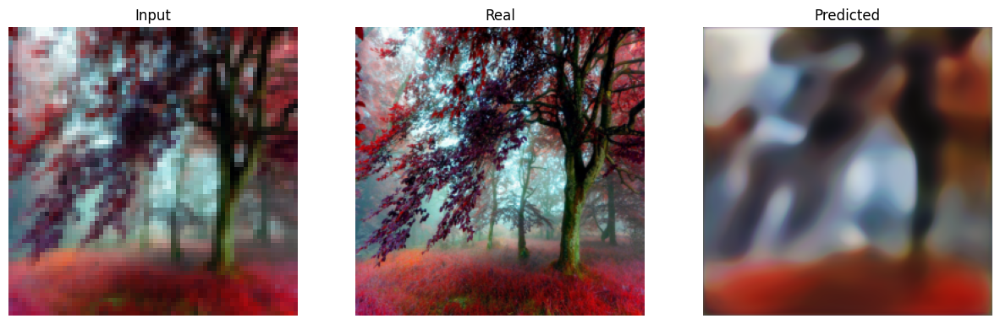

-----------------------------------------------------------
| End of epoch   5 | Time: 37.10s | Train psnr   18.045 | Train Loss    0.163 | Valid psnr   18.033 | Valid Loss    0.163 
-----------------------------------------------------------


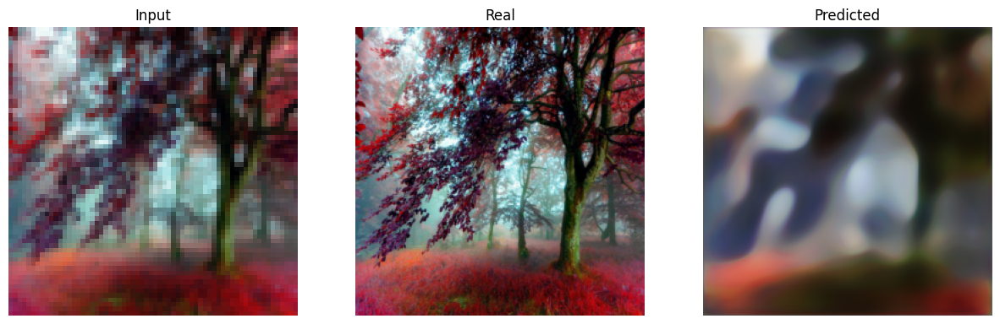

-----------------------------------------------------------
| End of epoch   6 | Time: 43.35s | Train psnr   17.814 | Train Loss    0.170 | Valid psnr   18.139 | Valid Loss    0.162 
-----------------------------------------------------------


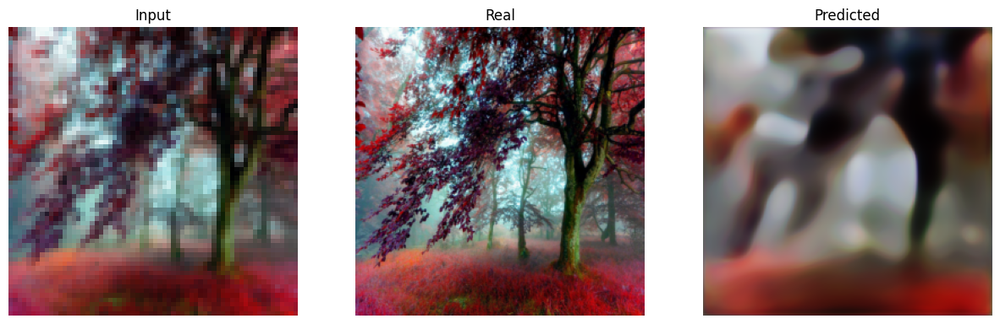

-----------------------------------------------------------
| End of epoch   7 | Time: 43.53s | Train psnr   18.230 | Train Loss    0.159 | Valid psnr   18.245 | Valid Loss    0.155 
-----------------------------------------------------------


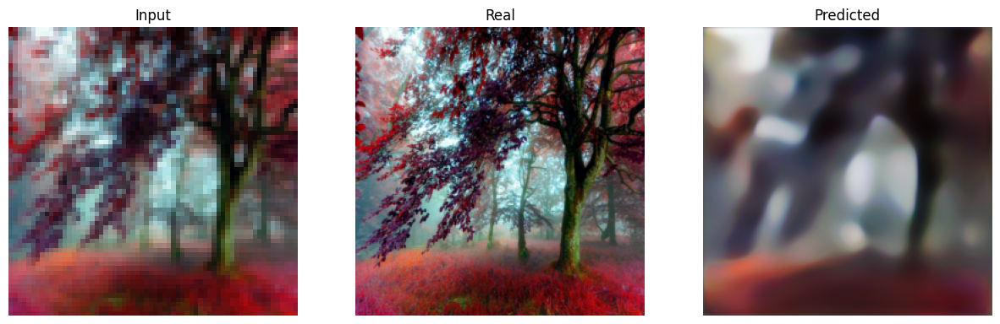

-----------------------------------------------------------
| End of epoch   8 | Time: 43.16s | Train psnr   18.462 | Train Loss    0.155 | Valid psnr   18.284 | Valid Loss    0.153 
-----------------------------------------------------------
-----------------------------------------------------------
| End of epoch   9 | Time: 44.06s | Train psnr   18.475 | Train Loss    0.154 | Valid psnr   17.948 | Valid Loss    0.167 
-----------------------------------------------------------
-----------------------------------------------------------
| End of epoch  10 | Time: 41.49s | Train psnr   18.669 | Train Loss    0.150 | Valid psnr   16.682 | Valid Loss    0.179 
-----------------------------------------------------------
-----------------------------------------------------------
| End of epoch  11 | Time: 41.70s | Train psnr   14.767 | Train Loss    0.290 | Valid psnr   12.316 | Valid Loss    0.344 
-----------------------------------------------------------
----------------------------

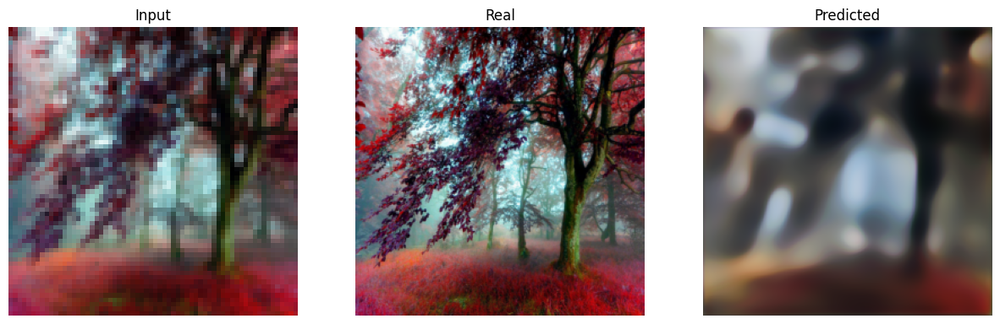

-----------------------------------------------------------
| End of epoch  17 | Time: 42.37s | Train psnr   18.196 | Train Loss    0.159 | Valid psnr   18.502 | Valid Loss    0.155 
-----------------------------------------------------------
-----------------------------------------------------------
| End of epoch  18 | Time: 43.50s | Train psnr   18.226 | Train Loss    0.160 | Valid psnr   17.884 | Valid Loss    0.172 
-----------------------------------------------------------
-----------------------------------------------------------
| End of epoch  19 | Time: 42.13s | Train psnr   18.397 | Train Loss    0.156 | Valid psnr   18.376 | Valid Loss    0.156 
-----------------------------------------------------------


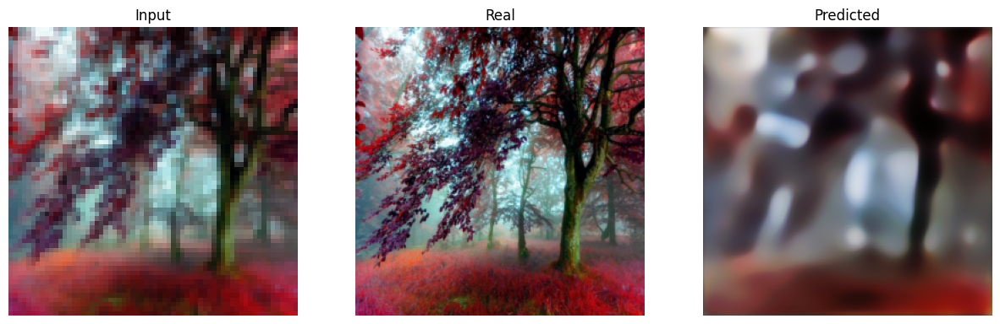

-----------------------------------------------------------
| End of epoch  20 | Time: 43.52s | Train psnr   18.606 | Train Loss    0.152 | Valid psnr   18.752 | Valid Loss    0.148 
-----------------------------------------------------------
-----------------------------------------------------------
| End of epoch  21 | Time: 42.48s | Train psnr   18.720 | Train Loss    0.148 | Valid psnr   18.734 | Valid Loss    0.150 
-----------------------------------------------------------


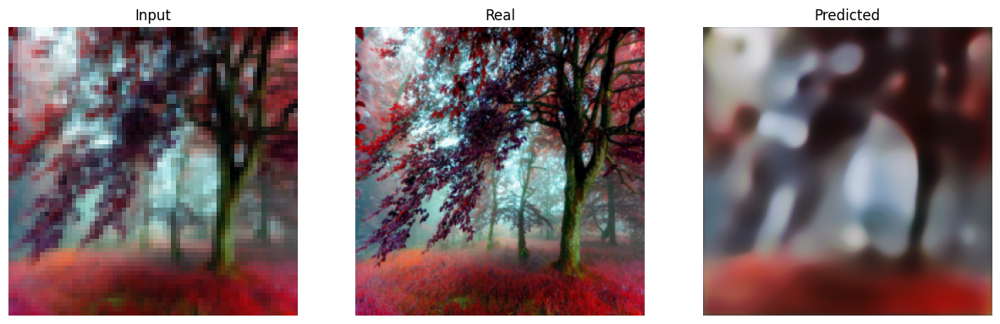

-----------------------------------------------------------
| End of epoch  22 | Time: 45.06s | Train psnr   18.777 | Train Loss    0.149 | Valid psnr   18.938 | Valid Loss    0.150 
-----------------------------------------------------------
-----------------------------------------------------------
| End of epoch  23 | Time: 42.43s | Train psnr   19.054 | Train Loss    0.142 | Valid psnr   18.454 | Valid Loss    0.161 
-----------------------------------------------------------


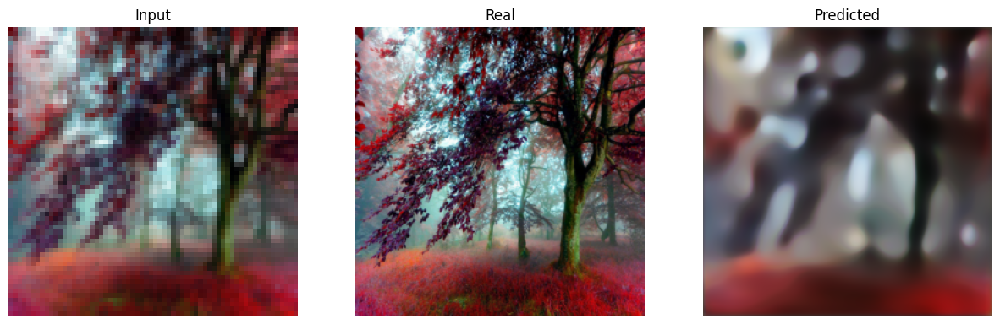

-----------------------------------------------------------
| End of epoch  24 | Time: 44.50s | Train psnr   18.981 | Train Loss    0.144 | Valid psnr   19.128 | Valid Loss    0.141 
-----------------------------------------------------------


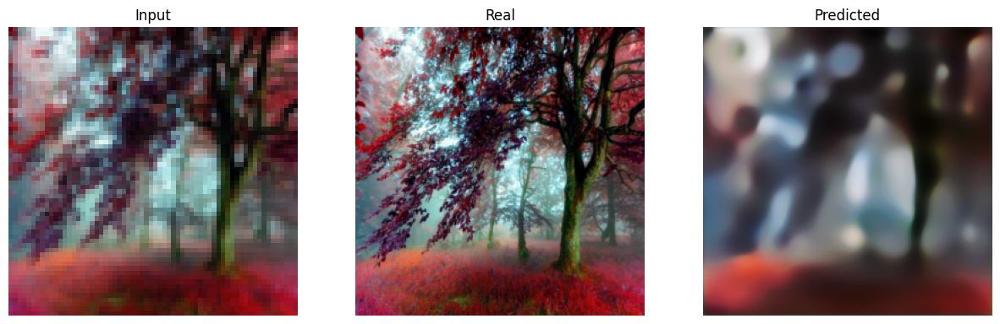

-----------------------------------------------------------
| End of epoch  25 | Time: 43.77s | Train psnr   19.057 | Train Loss    0.143 | Valid psnr   19.147 | Valid Loss    0.137 
-----------------------------------------------------------


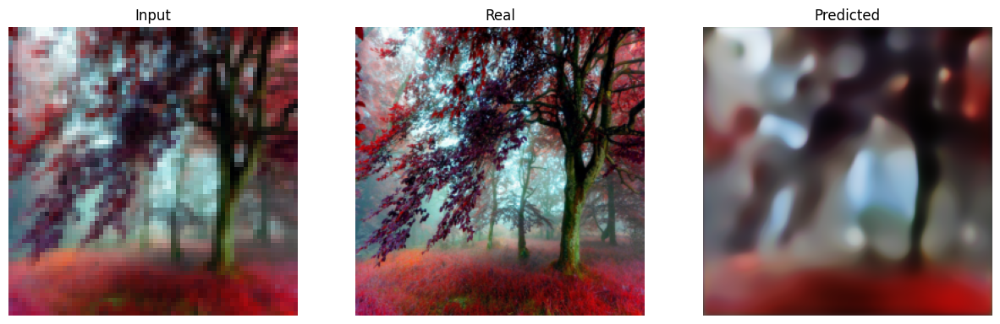

-----------------------------------------------------------
| End of epoch  26 | Time: 43.29s | Train psnr   19.104 | Train Loss    0.142 | Valid psnr   19.226 | Valid Loss    0.138 
-----------------------------------------------------------
-----------------------------------------------------------
| End of epoch  27 | Time: 42.06s | Train psnr   19.331 | Train Loss    0.137 | Valid psnr   19.180 | Valid Loss    0.140 
-----------------------------------------------------------
-----------------------------------------------------------
| End of epoch  28 | Time: 42.40s | Train psnr   19.240 | Train Loss    0.140 | Valid psnr   18.091 | Valid Loss    0.161 
-----------------------------------------------------------


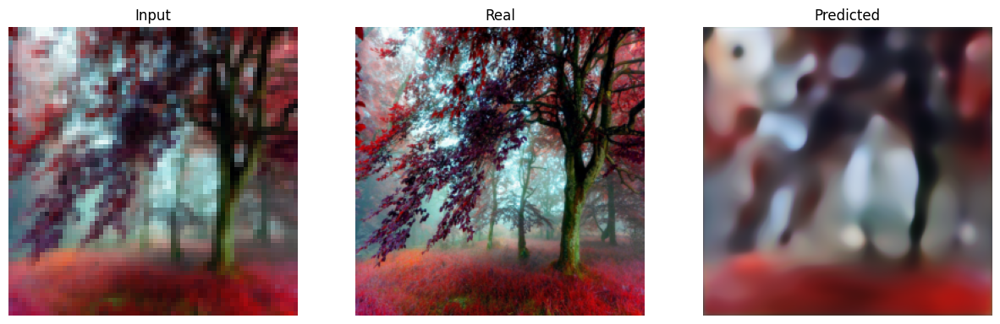

-----------------------------------------------------------
| End of epoch  29 | Time: 44.14s | Train psnr   19.215 | Train Loss    0.139 | Valid psnr   19.388 | Valid Loss    0.142 
-----------------------------------------------------------


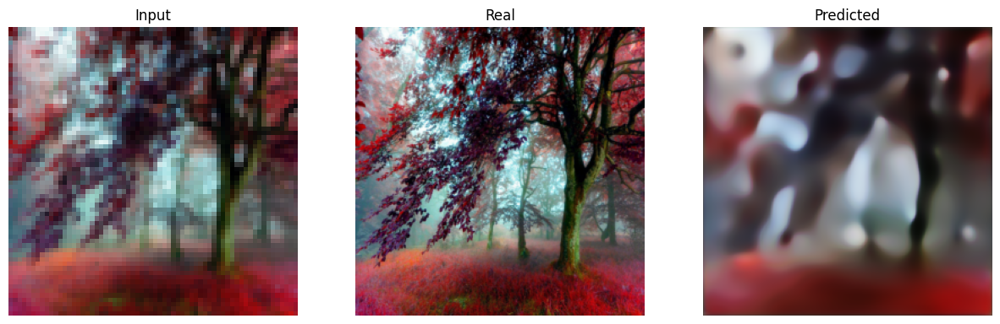

-----------------------------------------------------------
| End of epoch  30 | Time: 43.66s | Train psnr   19.420 | Train Loss    0.136 | Valid psnr   19.545 | Valid Loss    0.132 
-----------------------------------------------------------
-----------------------------------------------------------
| End of epoch  31 | Time: 43.02s | Train psnr   19.434 | Train Loss    0.136 | Valid psnr   19.234 | Valid Loss    0.143 
-----------------------------------------------------------
-----------------------------------------------------------
| End of epoch  32 | Time: 42.21s | Train psnr   19.502 | Train Loss    0.135 | Valid psnr   19.059 | Valid Loss    0.140 
-----------------------------------------------------------
-----------------------------------------------------------
| End of epoch  33 | Time: 41.71s | Train psnr   19.669 | Train Loss    0.132 | Valid psnr   18.931 | Valid Loss    0.142 
-----------------------------------------------------------
----------------------------

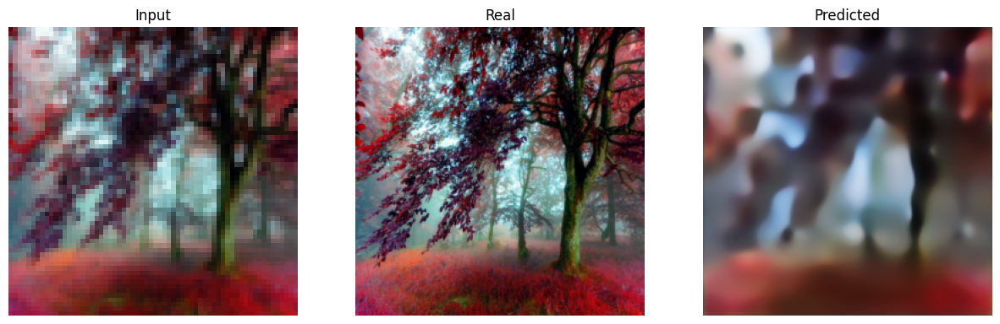

-----------------------------------------------------------
| End of epoch  38 | Time: 43.51s | Train psnr   19.850 | Train Loss    0.129 | Valid psnr   19.873 | Valid Loss    0.128 
-----------------------------------------------------------
-----------------------------------------------------------
| End of epoch  39 | Time: 42.31s | Train psnr   20.040 | Train Loss    0.125 | Valid psnr   19.598 | Valid Loss    0.134 
-----------------------------------------------------------
-----------------------------------------------------------
| End of epoch  40 | Time: 42.61s | Train psnr   19.964 | Train Loss    0.127 | Valid psnr   19.453 | Valid Loss    0.136 
-----------------------------------------------------------
-----------------------------------------------------------
| End of epoch  41 | Time: 41.65s | Train psnr   20.055 | Train Loss    0.125 | Valid psnr   19.853 | Valid Loss    0.129 
-----------------------------------------------------------
----------------------------

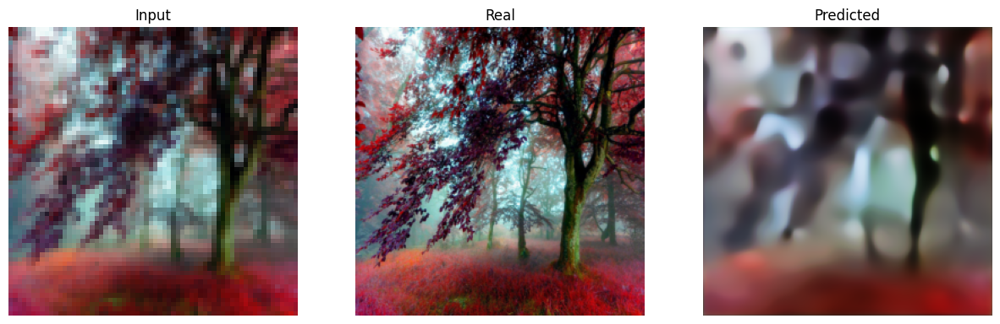

-----------------------------------------------------------
| End of epoch  51 | Time: 44.14s | Train psnr   20.148 | Train Loss    0.125 | Valid psnr   20.157 | Valid Loss    0.122 
-----------------------------------------------------------
-----------------------------------------------------------
| End of epoch  52 | Time: 42.34s | Train psnr   20.042 | Train Loss    0.126 | Valid psnr   19.853 | Valid Loss    0.130 
-----------------------------------------------------------
-----------------------------------------------------------
| End of epoch  53 | Time: 43.22s | Train psnr   20.045 | Train Loss    0.126 | Valid psnr   19.997 | Valid Loss    0.128 
-----------------------------------------------------------
-----------------------------------------------------------
| End of epoch  54 | Time: 45.83s | Train psnr   20.152 | Train Loss    0.124 | Valid psnr   20.155 | Valid Loss    0.125 
-----------------------------------------------------------
----------------------------

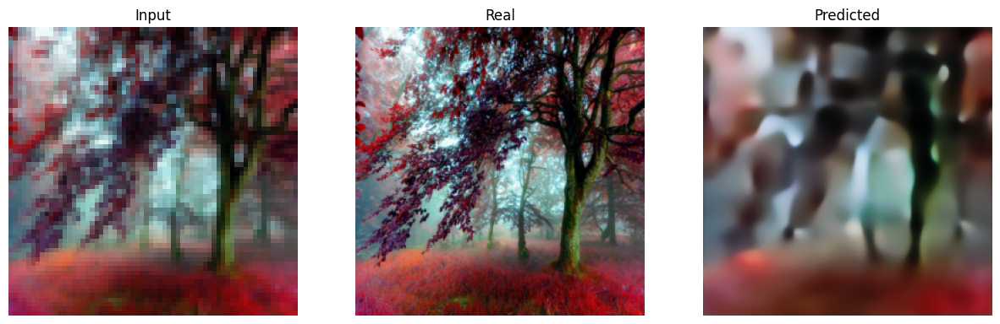

-----------------------------------------------------------
| End of epoch  60 | Time: 42.87s | Train psnr   20.349 | Train Loss    0.121 | Valid psnr   20.163 | Valid Loss    0.122 
-----------------------------------------------------------
-----------------------------------------------------------
| End of epoch  61 | Time: 42.38s | Train psnr   20.319 | Train Loss    0.122 | Valid psnr   20.128 | Valid Loss    0.126 
-----------------------------------------------------------
-----------------------------------------------------------
| End of epoch  62 | Time: 43.44s | Train psnr   20.457 | Train Loss    0.119 | Valid psnr   20.094 | Valid Loss    0.124 
-----------------------------------------------------------


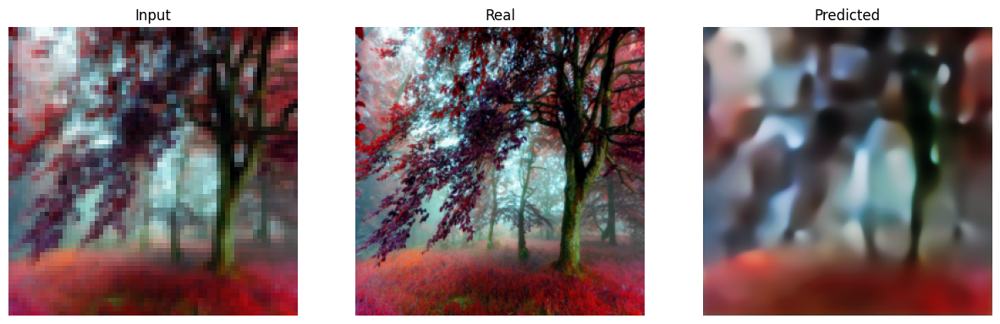

-----------------------------------------------------------
| End of epoch  63 | Time: 43.68s | Train psnr   20.540 | Train Loss    0.118 | Valid psnr   20.444 | Valid Loss    0.118 
-----------------------------------------------------------
-----------------------------------------------------------
| End of epoch  64 | Time: 42.09s | Train psnr   20.539 | Train Loss    0.119 | Valid psnr   19.834 | Valid Loss    0.136 
-----------------------------------------------------------
-----------------------------------------------------------
| End of epoch  65 | Time: 43.54s | Train psnr   20.098 | Train Loss    0.125 | Valid psnr   20.022 | Valid Loss    0.132 
-----------------------------------------------------------
-----------------------------------------------------------
| End of epoch  66 | Time: 42.59s | Train psnr   20.325 | Train Loss    0.123 | Valid psnr   19.803 | Valid Loss    0.125 
-----------------------------------------------------------


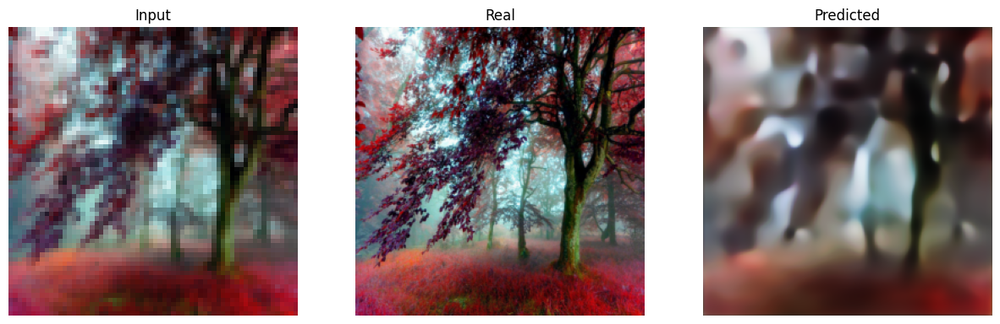

-----------------------------------------------------------
| End of epoch  67 | Time: 43.90s | Train psnr   20.520 | Train Loss    0.119 | Valid psnr   20.547 | Valid Loss    0.116 
-----------------------------------------------------------


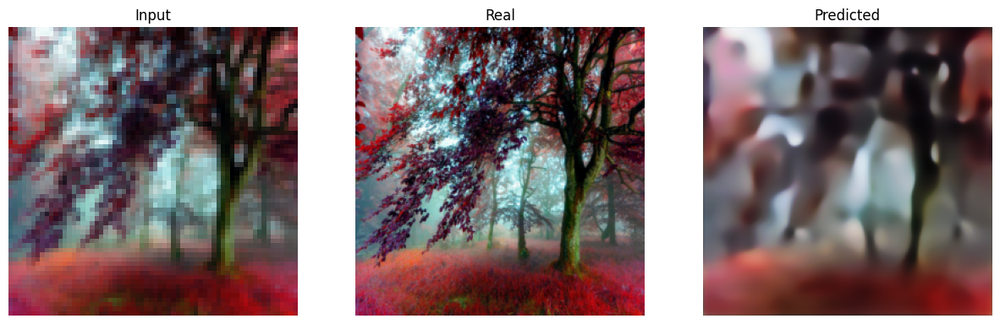

-----------------------------------------------------------
| End of epoch  68 | Time: 43.81s | Train psnr   20.668 | Train Loss    0.115 | Valid psnr   20.621 | Valid Loss    0.119 
-----------------------------------------------------------
-----------------------------------------------------------
| End of epoch  69 | Time: 42.81s | Train psnr   20.609 | Train Loss    0.117 | Valid psnr   20.581 | Valid Loss    0.116 
-----------------------------------------------------------
-----------------------------------------------------------
| End of epoch  70 | Time: 42.63s | Train psnr   20.742 | Train Loss    0.116 | Valid psnr   20.259 | Valid Loss    0.124 
-----------------------------------------------------------


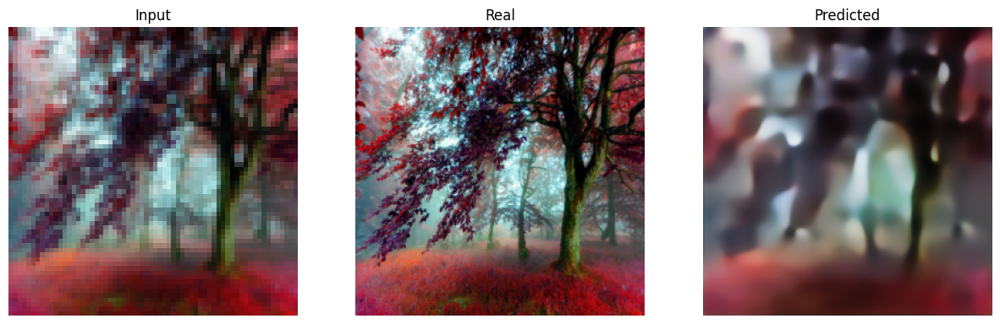

-----------------------------------------------------------
| End of epoch  71 | Time: 43.83s | Train psnr   20.781 | Train Loss    0.113 | Valid psnr   20.753 | Valid Loss    0.113 
-----------------------------------------------------------


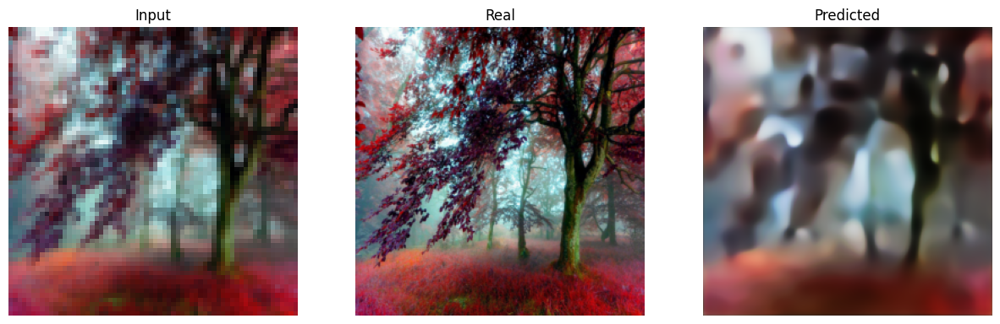

-----------------------------------------------------------
| End of epoch  72 | Time: 45.62s | Train psnr   20.887 | Train Loss    0.112 | Valid psnr   20.762 | Valid Loss    0.112 
-----------------------------------------------------------
-----------------------------------------------------------
| End of epoch  73 | Time: 44.34s | Train psnr   20.903 | Train Loss    0.112 | Valid psnr   20.202 | Valid Loss    0.120 
-----------------------------------------------------------
-----------------------------------------------------------
| End of epoch  74 | Time: 42.54s | Train psnr   20.875 | Train Loss    0.113 | Valid psnr   19.838 | Valid Loss    0.128 
-----------------------------------------------------------
-----------------------------------------------------------
| End of epoch  75 | Time: 41.40s | Train psnr   20.823 | Train Loss    0.115 | Valid psnr   19.931 | Valid Loss    0.129 
-----------------------------------------------------------
----------------------------

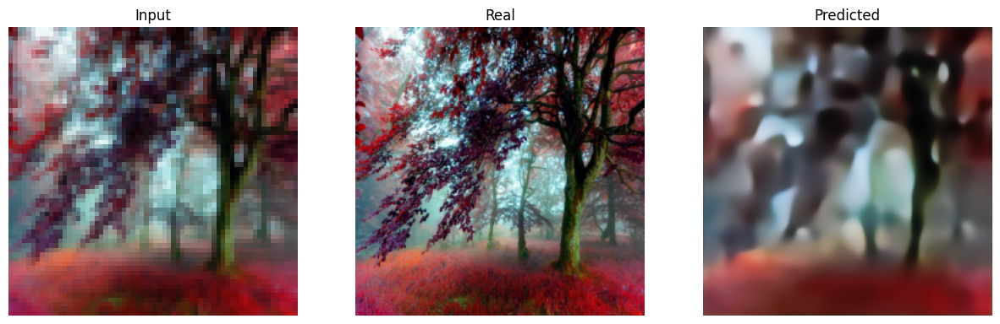

-----------------------------------------------------------
| End of epoch  78 | Time: 43.50s | Train psnr   20.928 | Train Loss    0.112 | Valid psnr   20.834 | Valid Loss    0.112 
-----------------------------------------------------------
-----------------------------------------------------------
| End of epoch  79 | Time: 42.25s | Train psnr   21.089 | Train Loss    0.109 | Valid psnr   20.546 | Valid Loss    0.118 
-----------------------------------------------------------
-----------------------------------------------------------
| End of epoch  80 | Time: 42.56s | Train psnr   21.058 | Train Loss    0.110 | Valid psnr   20.530 | Valid Loss    0.115 
-----------------------------------------------------------
-----------------------------------------------------------
| End of epoch  81 | Time: 41.66s | Train psnr   21.152 | Train Loss    0.108 | Valid psnr   20.611 | Valid Loss    0.119 
-----------------------------------------------------------
----------------------------

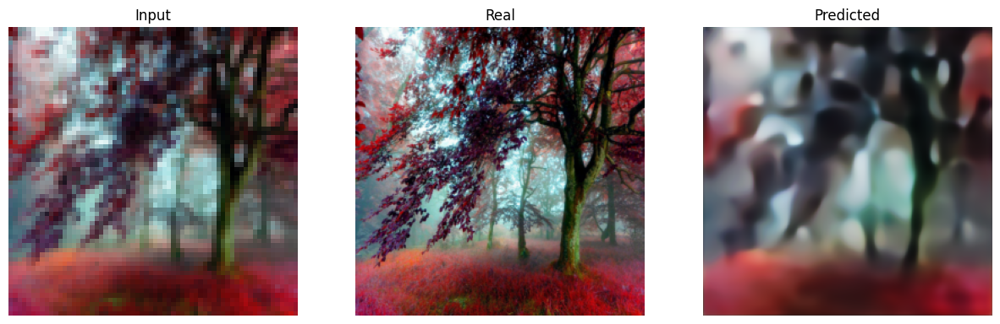

-----------------------------------------------------------
| End of epoch  89 | Time: 42.31s | Train psnr   21.216 | Train Loss    0.108 | Valid psnr   20.898 | Valid Loss    0.114 
-----------------------------------------------------------
-----------------------------------------------------------
| End of epoch  90 | Time: 43.13s | Train psnr   21.185 | Train Loss    0.109 | Valid psnr   20.682 | Valid Loss    0.116 
-----------------------------------------------------------
-----------------------------------------------------------
| End of epoch  91 | Time: 42.10s | Train psnr   21.280 | Train Loss    0.106 | Valid psnr   20.775 | Valid Loss    0.111 
-----------------------------------------------------------
-----------------------------------------------------------
| End of epoch  92 | Time: 41.83s | Train psnr   21.159 | Train Loss    0.109 | Valid psnr   20.686 | Valid Loss    0.113 
-----------------------------------------------------------
----------------------------

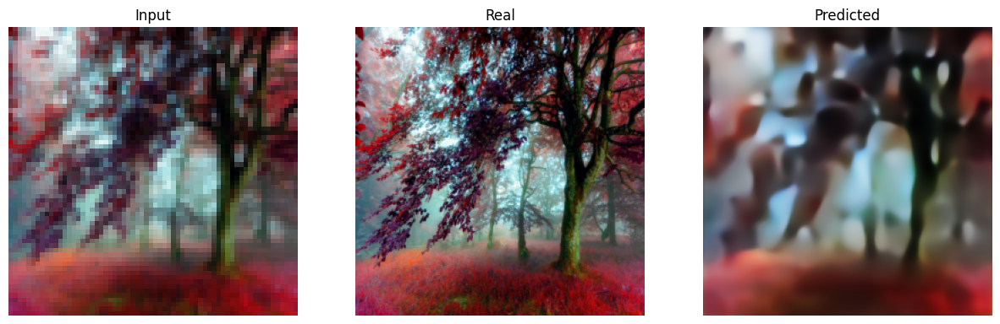

-----------------------------------------------------------
| End of epoch  95 | Time: 41.88s | Train psnr   21.459 | Train Loss    0.104 | Valid psnr   21.118 | Valid Loss    0.106 
-----------------------------------------------------------
-----------------------------------------------------------
| End of epoch  96 | Time: 41.44s | Train psnr   21.414 | Train Loss    0.105 | Valid psnr   20.835 | Valid Loss    0.112 
-----------------------------------------------------------
-----------------------------------------------------------
| End of epoch  97 | Time: 41.12s | Train psnr   21.440 | Train Loss    0.104 | Valid psnr   20.702 | Valid Loss    0.121 
-----------------------------------------------------------
-----------------------------------------------------------
| End of epoch  98 | Time: 40.83s | Train psnr   21.442 | Train Loss    0.104 | Valid psnr   20.922 | Valid Loss    0.114 
-----------------------------------------------------------
----------------------------

In [ ]:
import torch.optim as optim

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
SR_unet_model_noskip = SR_Unet_NoSkip().to(device)
SR_unet_model_noskip.to(device)

criterion = nn.L1Loss()

optimizer = optim.Adam(SR_unet_model_noskip.parameters(), lr=1e-4, betas=[0.5,0.999])

save_model = './UNET'
os.makedirs(save_model, exist_ok = True)

EPOCHS = 100
SR_unet_model_noskip, metrics = train(
    SR_unet_model_noskip, 'SR_unet_model_noskip', save_model, optimizer, criterion, train_loader, test_loader, EPOCHS, device
)

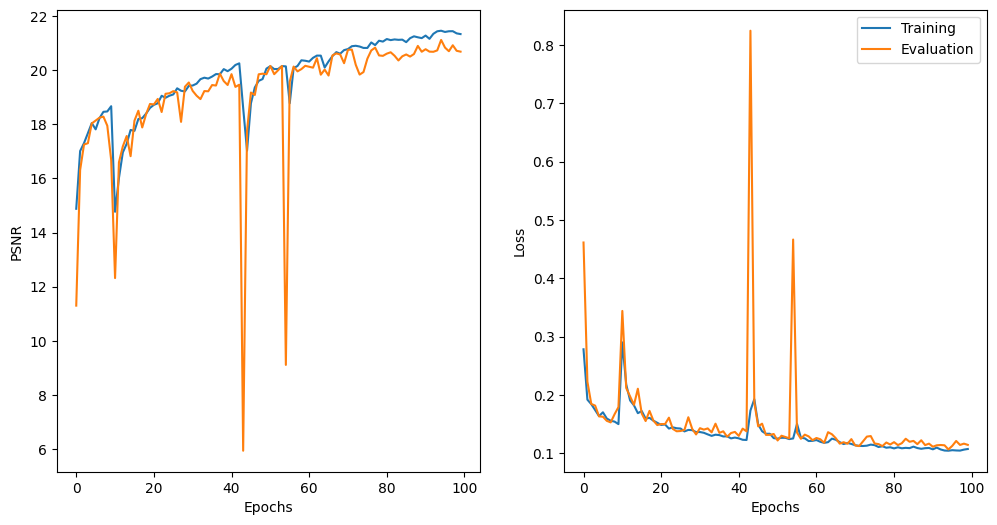

In [ ]:
plot_result(
    EPOCHS,
    metrics["train_psnr"],
    metrics["valid_psnr"],
    metrics["train_loss"],
    metrics["valid_loss"]
)

In [ ]:
test_psnr, test_loss = evaluate_epoch(SR_unet_model_noskip, criterion, test_loader, device)
test_psnr, test_loss

(tensor(21.1184, device='cuda:0'), 0.10625930999716122)

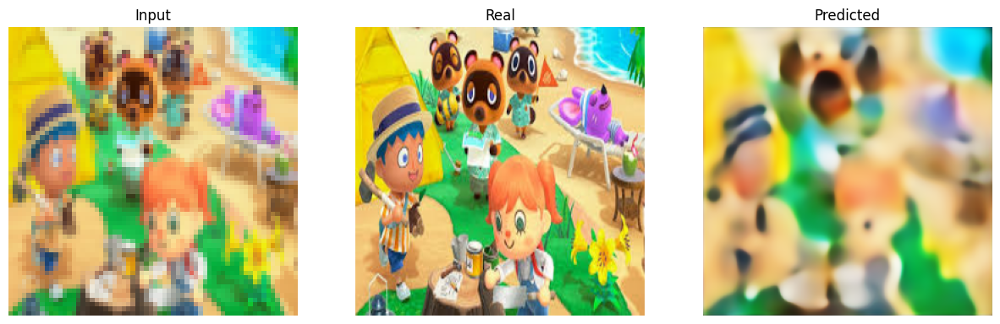

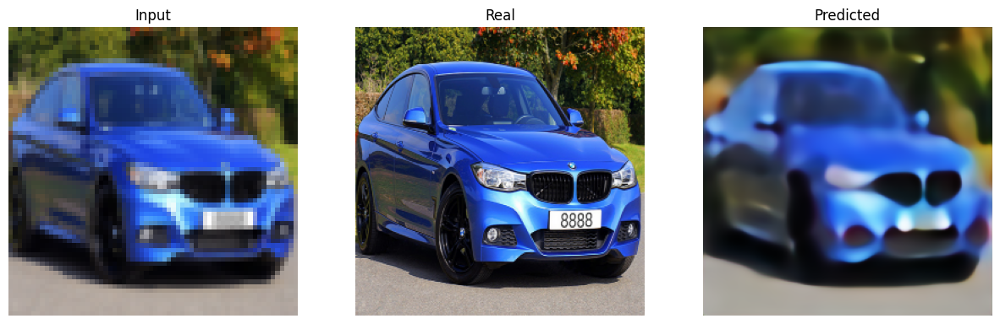

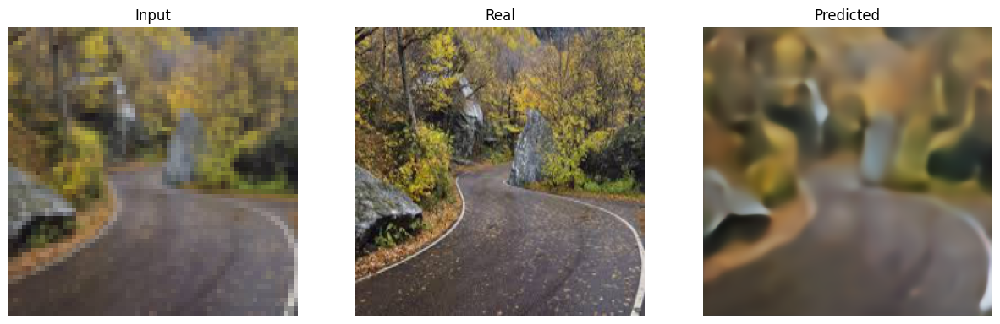

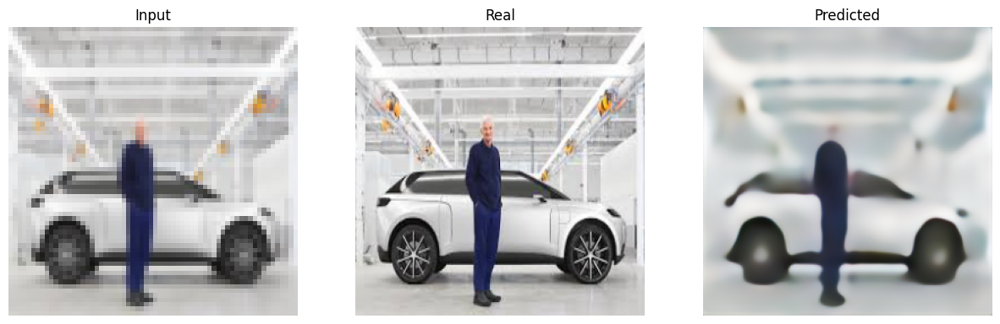

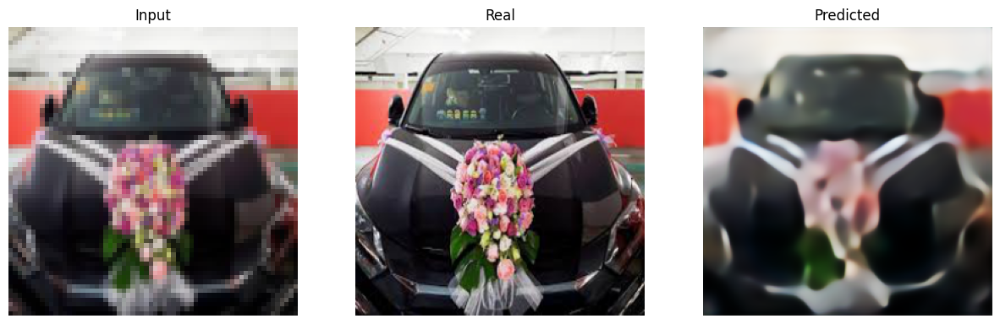

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


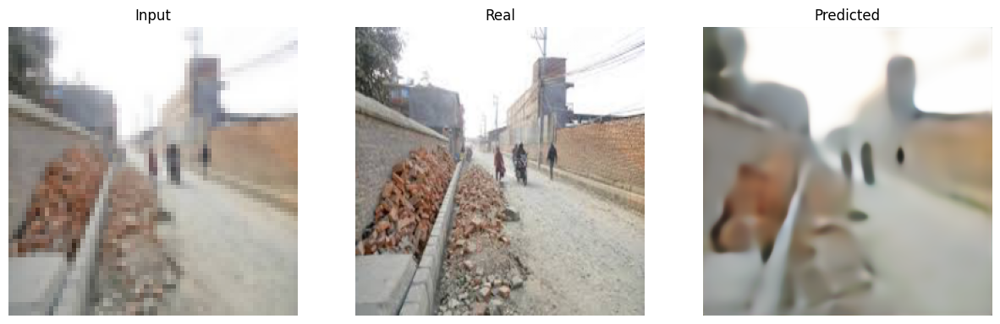

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


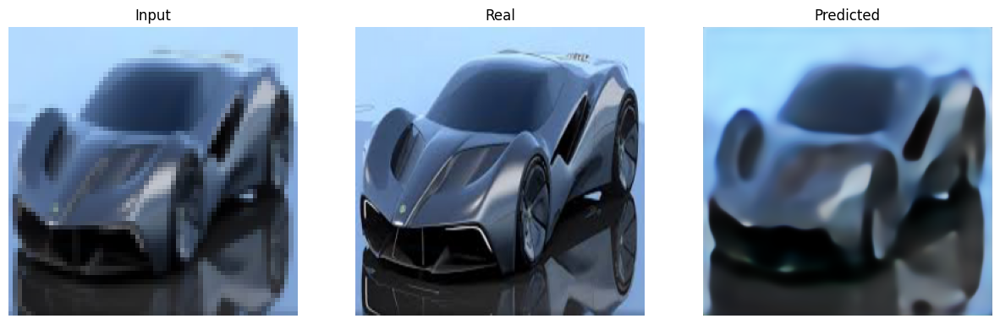

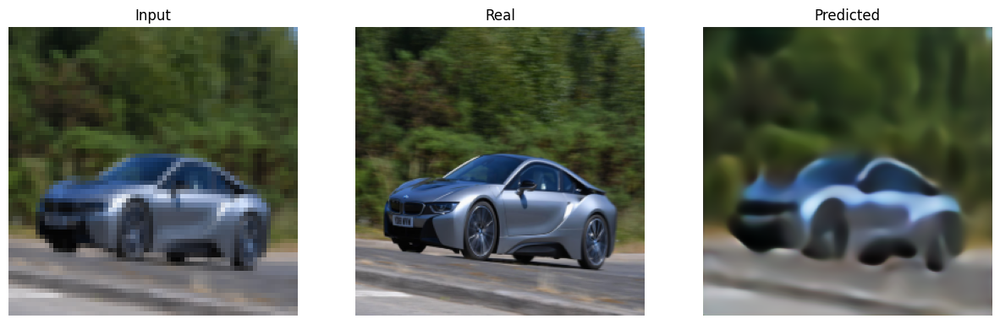

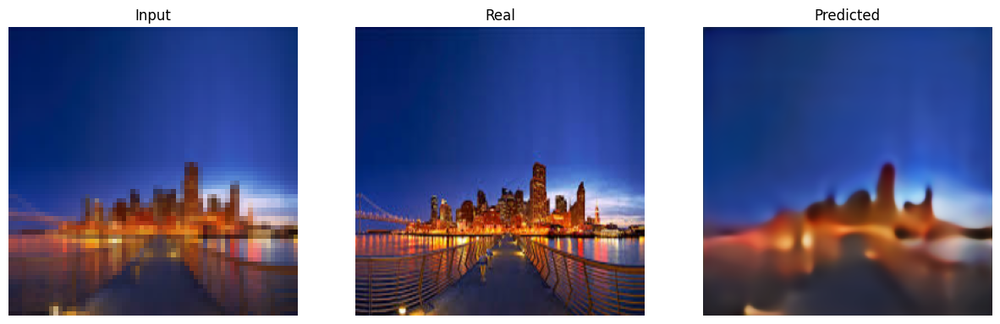

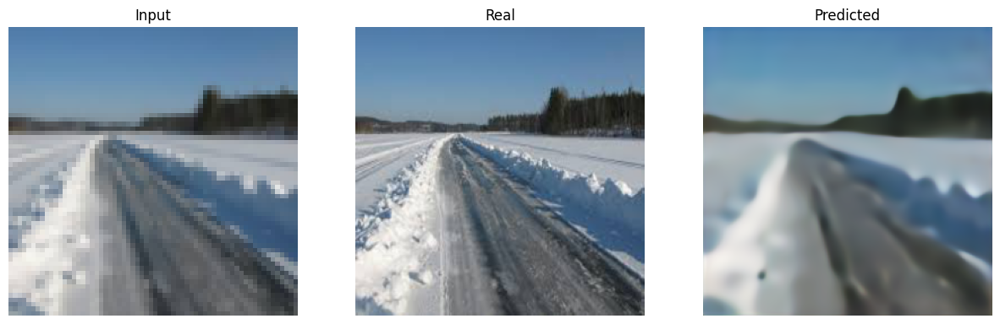

In [ ]:
predict_and_display(SR_unet_model_noskip, train_loader, device)

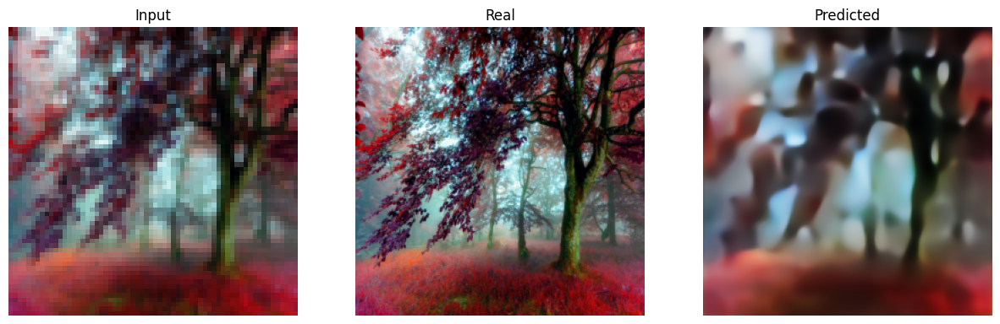

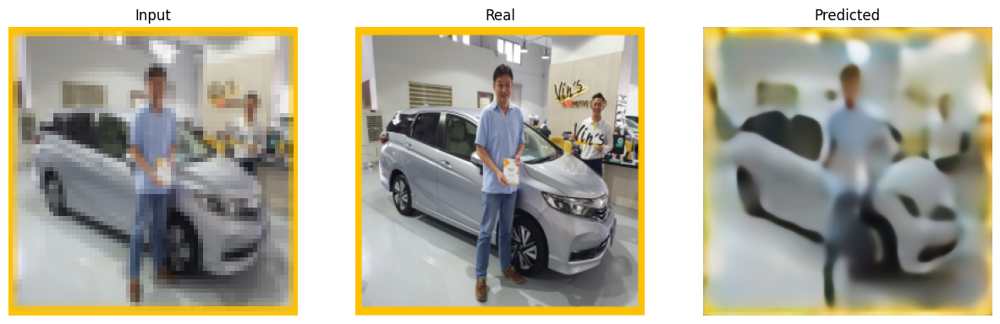

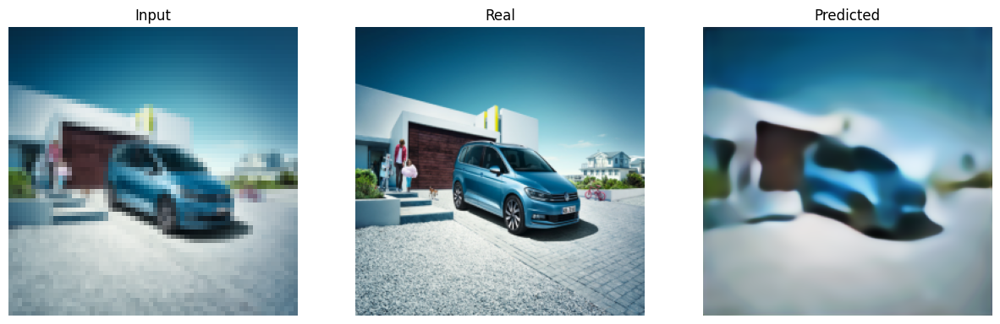

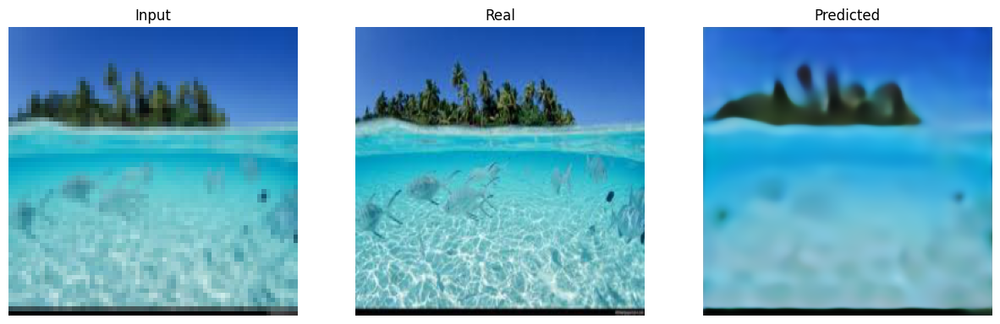

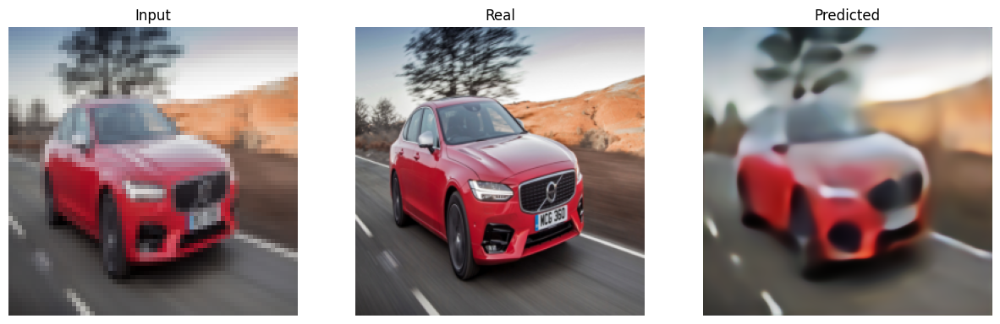

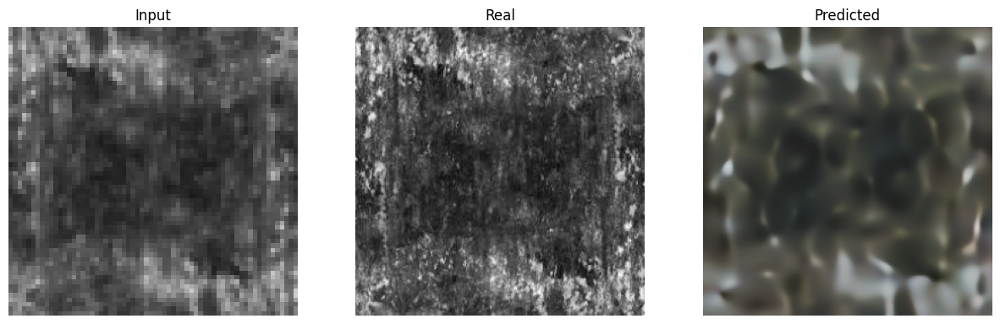

In [ ]:
predict_and_display(SR_unet_model_noskip, test_loader, device)

#### Unet

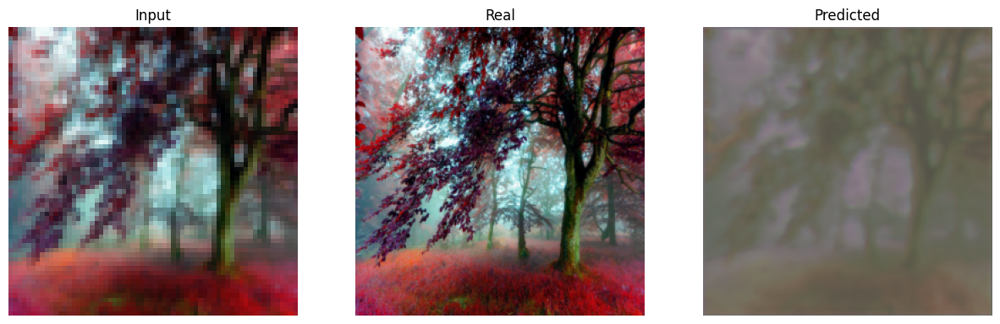

-----------------------------------------------------------
| End of epoch   1 | Time: 40.25s | Train psnr   18.284 | Train Loss    0.193 | Valid psnr   12.598 | Valid Loss    0.396 
-----------------------------------------------------------


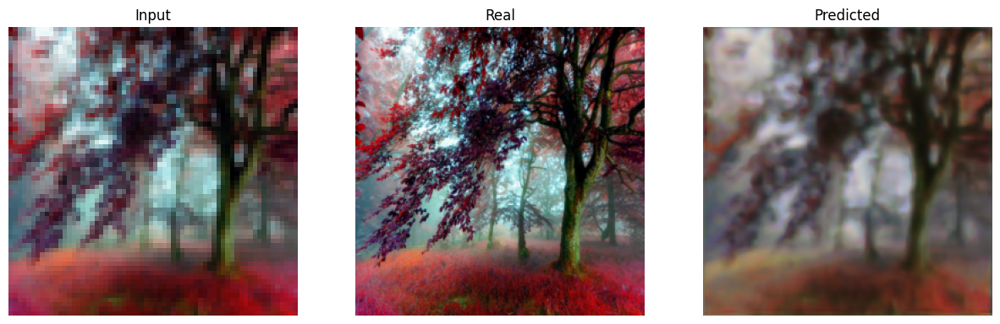

-----------------------------------------------------------
| End of epoch   2 | Time: 41.07s | Train psnr   21.355 | Train Loss    0.119 | Valid psnr   19.526 | Valid Loss    0.156 
-----------------------------------------------------------


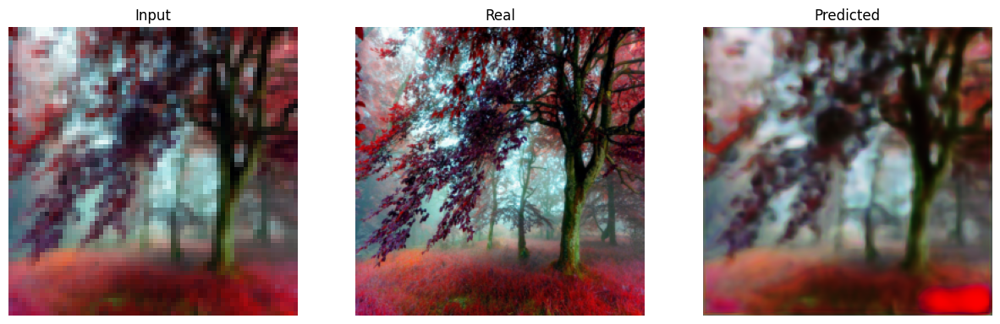

-----------------------------------------------------------
| End of epoch   3 | Time: 41.38s | Train psnr   21.818 | Train Loss    0.114 | Valid psnr   22.504 | Valid Loss    0.100 
-----------------------------------------------------------


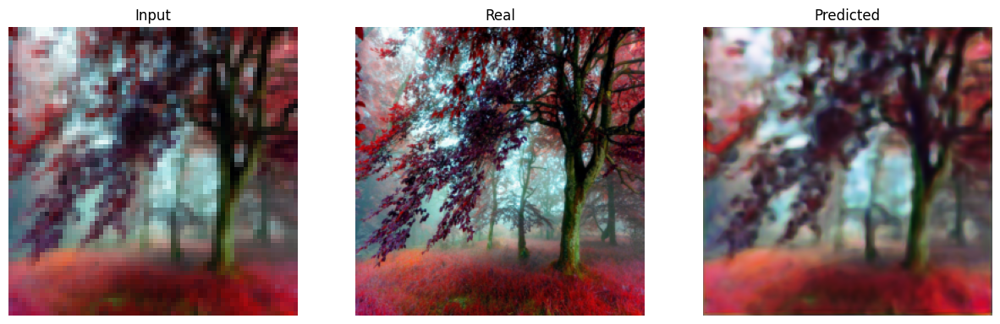

-----------------------------------------------------------
| End of epoch   4 | Time: 40.67s | Train psnr   22.147 | Train Loss    0.110 | Valid psnr   22.580 | Valid Loss    0.098 
-----------------------------------------------------------


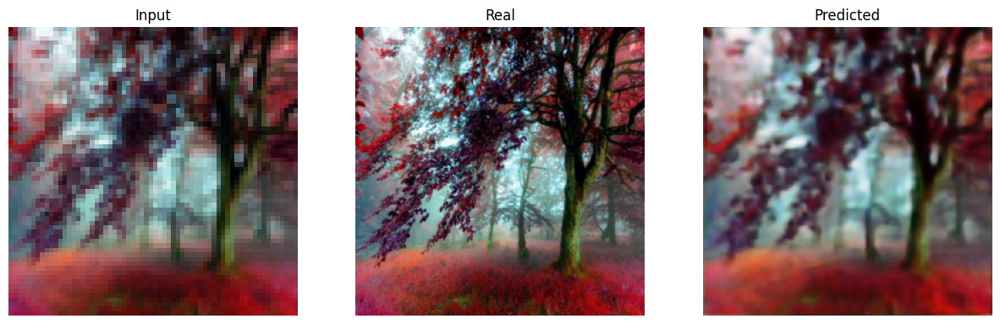

-----------------------------------------------------------
| End of epoch   5 | Time: 41.72s | Train psnr   22.897 | Train Loss    0.097 | Valid psnr   23.543 | Valid Loss    0.086 
-----------------------------------------------------------
-----------------------------------------------------------
| End of epoch   6 | Time: 39.18s | Train psnr   22.779 | Train Loss    0.100 | Valid psnr   23.303 | Valid Loss    0.087 
-----------------------------------------------------------
-----------------------------------------------------------
| End of epoch   7 | Time: 40.15s | Train psnr   22.958 | Train Loss    0.098 | Valid psnr   23.310 | Valid Loss    0.090 
-----------------------------------------------------------


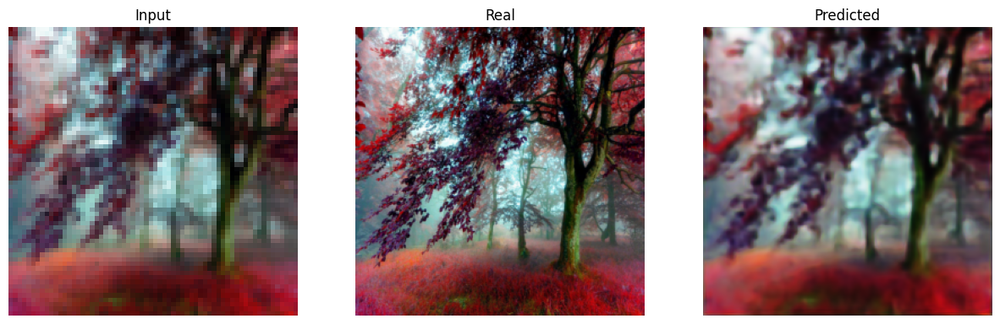

-----------------------------------------------------------
| End of epoch   8 | Time: 40.27s | Train psnr   23.615 | Train Loss    0.087 | Valid psnr   24.081 | Valid Loss    0.078 
-----------------------------------------------------------
-----------------------------------------------------------
| End of epoch   9 | Time: 44.38s | Train psnr   23.295 | Train Loss    0.093 | Valid psnr   23.502 | Valid Loss    0.088 
-----------------------------------------------------------


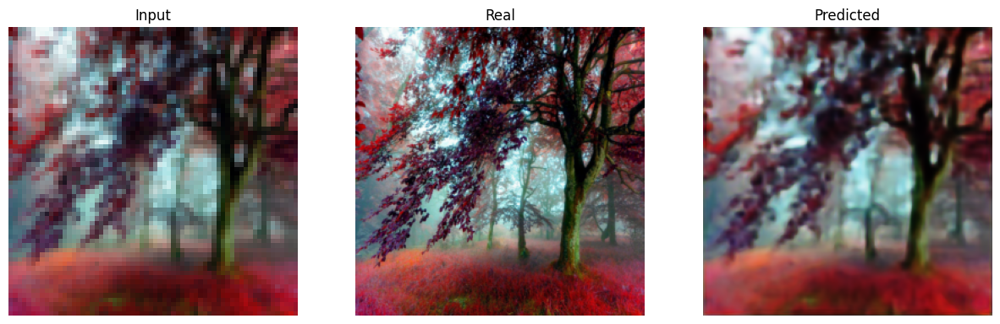

-----------------------------------------------------------
| End of epoch  10 | Time: 46.57s | Train psnr   23.624 | Train Loss    0.087 | Valid psnr   24.246 | Valid Loss    0.075 
-----------------------------------------------------------


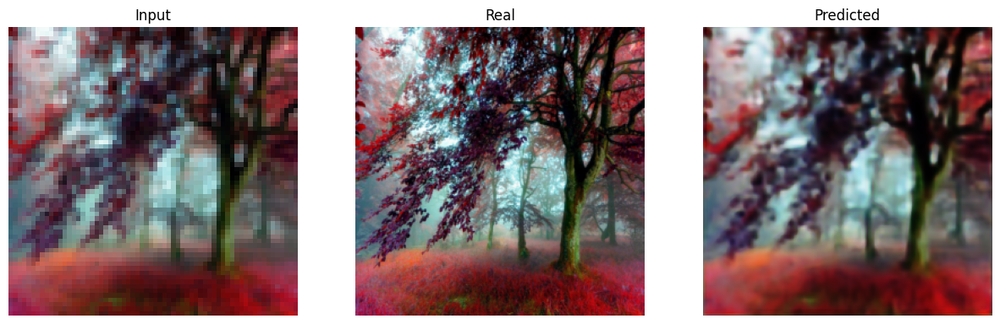

-----------------------------------------------------------
| End of epoch  11 | Time: 39.13s | Train psnr   23.720 | Train Loss    0.086 | Valid psnr   24.252 | Valid Loss    0.077 
-----------------------------------------------------------


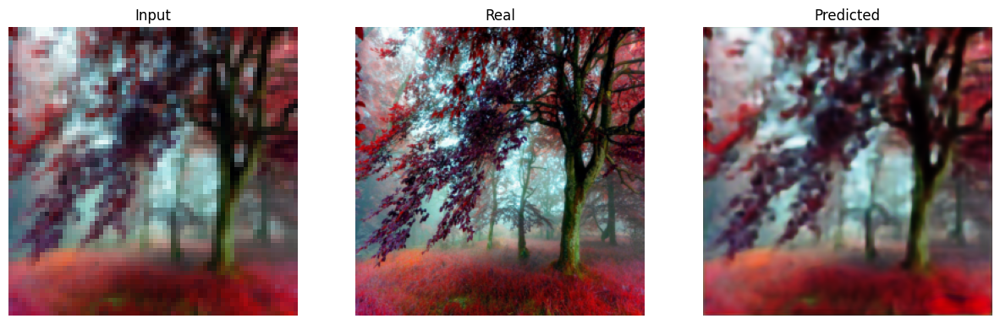

-----------------------------------------------------------
| End of epoch  12 | Time: 40.27s | Train psnr   23.994 | Train Loss    0.082 | Valid psnr   24.310 | Valid Loss    0.075 
-----------------------------------------------------------
-----------------------------------------------------------
| End of epoch  13 | Time: 39.28s | Train psnr   23.908 | Train Loss    0.084 | Valid psnr   24.252 | Valid Loss    0.078 
-----------------------------------------------------------


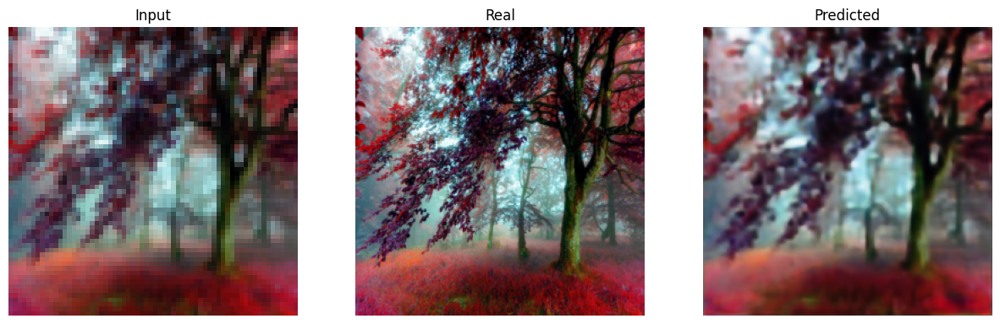

-----------------------------------------------------------
| End of epoch  14 | Time: 41.21s | Train psnr   23.969 | Train Loss    0.083 | Valid psnr   24.322 | Valid Loss    0.074 
-----------------------------------------------------------
-----------------------------------------------------------
| End of epoch  15 | Time: 39.50s | Train psnr   24.150 | Train Loss    0.080 | Valid psnr   24.315 | Valid Loss    0.076 
-----------------------------------------------------------


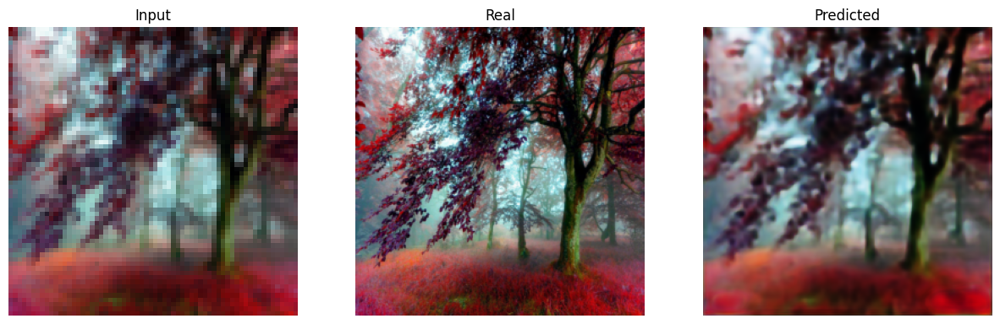

-----------------------------------------------------------
| End of epoch  16 | Time: 39.86s | Train psnr   24.184 | Train Loss    0.080 | Valid psnr   24.331 | Valid Loss    0.075 
-----------------------------------------------------------


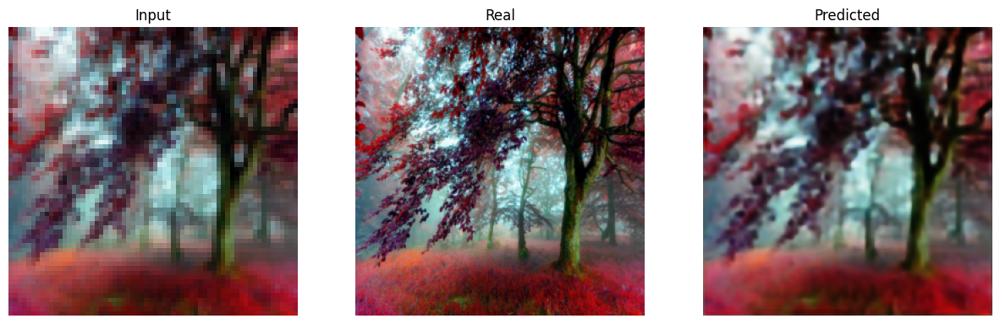

-----------------------------------------------------------
| End of epoch  17 | Time: 40.17s | Train psnr   24.146 | Train Loss    0.081 | Valid psnr   24.596 | Valid Loss    0.072 
-----------------------------------------------------------
-----------------------------------------------------------
| End of epoch  18 | Time: 39.12s | Train psnr   24.170 | Train Loss    0.080 | Valid psnr   24.359 | Valid Loss    0.076 
-----------------------------------------------------------
-----------------------------------------------------------
| End of epoch  19 | Time: 39.58s | Train psnr   24.349 | Train Loss    0.078 | Valid psnr   24.591 | Valid Loss    0.070 
-----------------------------------------------------------
-----------------------------------------------------------
| End of epoch  20 | Time: 39.20s | Train psnr   24.292 | Train Loss    0.079 | Valid psnr   24.544 | Valid Loss    0.070 
-----------------------------------------------------------
----------------------------

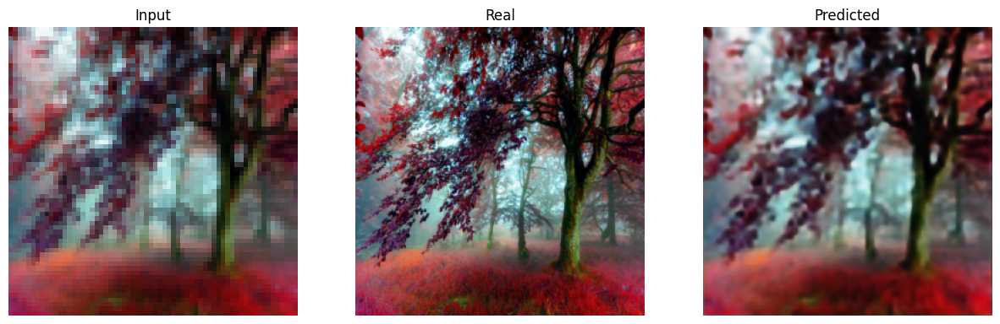

-----------------------------------------------------------
| End of epoch  22 | Time: 40.76s | Train psnr   24.313 | Train Loss    0.078 | Valid psnr   24.651 | Valid Loss    0.072 
-----------------------------------------------------------
-----------------------------------------------------------
| End of epoch  23 | Time: 38.80s | Train psnr   24.462 | Train Loss    0.076 | Valid psnr   24.615 | Valid Loss    0.073 
-----------------------------------------------------------


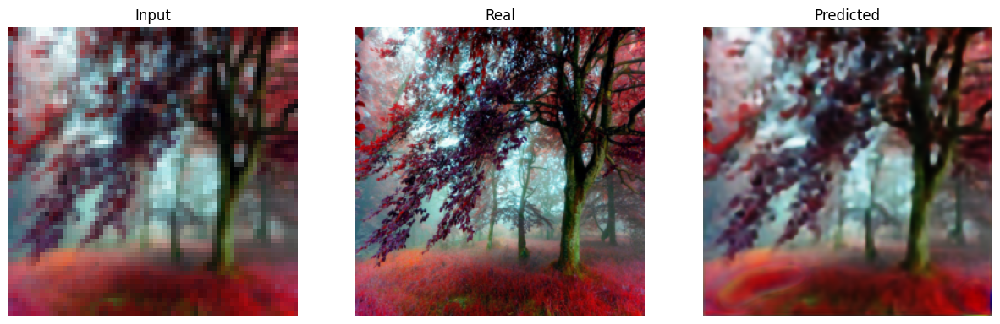

-----------------------------------------------------------
| End of epoch  24 | Time: 42.33s | Train psnr   24.485 | Train Loss    0.076 | Valid psnr   24.760 | Valid Loss    0.069 
-----------------------------------------------------------
-----------------------------------------------------------
| End of epoch  25 | Time: 42.08s | Train psnr   24.578 | Train Loss    0.074 | Valid psnr   24.738 | Valid Loss    0.072 
-----------------------------------------------------------
-----------------------------------------------------------
| End of epoch  26 | Time: 40.83s | Train psnr   24.583 | Train Loss    0.074 | Valid psnr   24.514 | Valid Loss    0.072 
-----------------------------------------------------------
-----------------------------------------------------------
| End of epoch  27 | Time: 40.48s | Train psnr   24.334 | Train Loss    0.079 | Valid psnr   24.526 | Valid Loss    0.073 
-----------------------------------------------------------
----------------------------

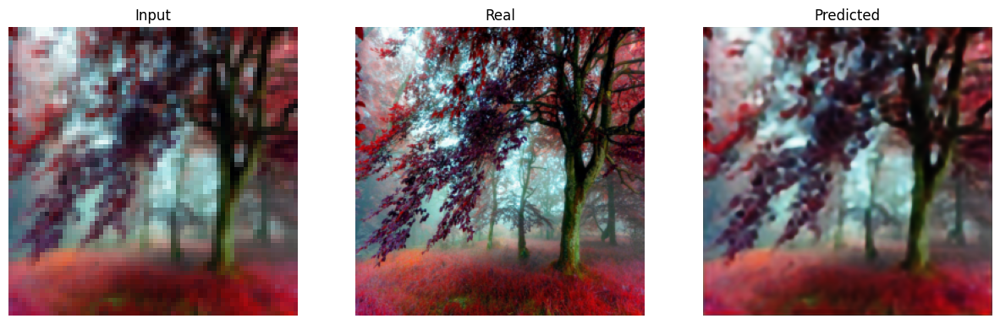

-----------------------------------------------------------
| End of epoch  35 | Time: 40.28s | Train psnr   24.706 | Train Loss    0.073 | Valid psnr   24.786 | Valid Loss    0.069 
-----------------------------------------------------------
-----------------------------------------------------------
| End of epoch  36 | Time: 40.97s | Train psnr   24.524 | Train Loss    0.076 | Valid psnr   24.706 | Valid Loss    0.071 
-----------------------------------------------------------
-----------------------------------------------------------
| End of epoch  37 | Time: 40.08s | Train psnr   24.658 | Train Loss    0.074 | Valid psnr   24.667 | Valid Loss    0.071 
-----------------------------------------------------------
-----------------------------------------------------------
| End of epoch  38 | Time: 39.14s | Train psnr   24.702 | Train Loss    0.073 | Valid psnr   24.636 | Valid Loss    0.075 
-----------------------------------------------------------


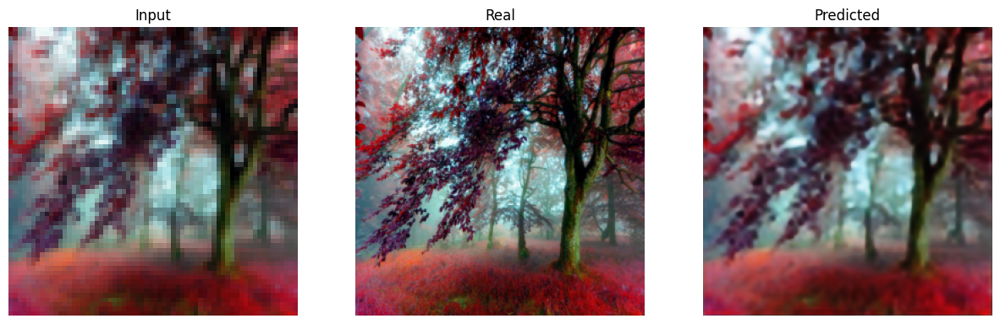

-----------------------------------------------------------
| End of epoch  39 | Time: 40.00s | Train psnr   24.792 | Train Loss    0.072 | Valid psnr   24.790 | Valid Loss    0.071 
-----------------------------------------------------------


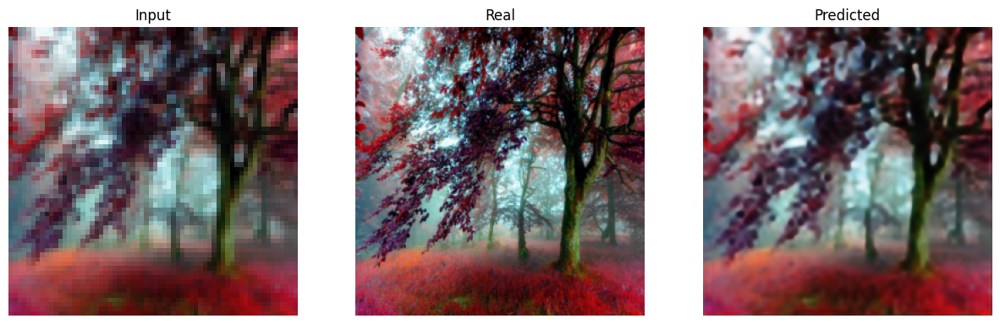

-----------------------------------------------------------
| End of epoch  40 | Time: 40.86s | Train psnr   24.769 | Train Loss    0.072 | Valid psnr   24.978 | Valid Loss    0.067 
-----------------------------------------------------------
-----------------------------------------------------------
| End of epoch  41 | Time: 40.29s | Train psnr   24.774 | Train Loss    0.072 | Valid psnr   24.885 | Valid Loss    0.071 
-----------------------------------------------------------
-----------------------------------------------------------
| End of epoch  42 | Time: 39.42s | Train psnr   24.521 | Train Loss    0.076 | Valid psnr   24.972 | Valid Loss    0.067 
-----------------------------------------------------------
-----------------------------------------------------------
| End of epoch  43 | Time: 39.16s | Train psnr   24.775 | Train Loss    0.072 | Valid psnr   24.933 | Valid Loss    0.068 
-----------------------------------------------------------
----------------------------

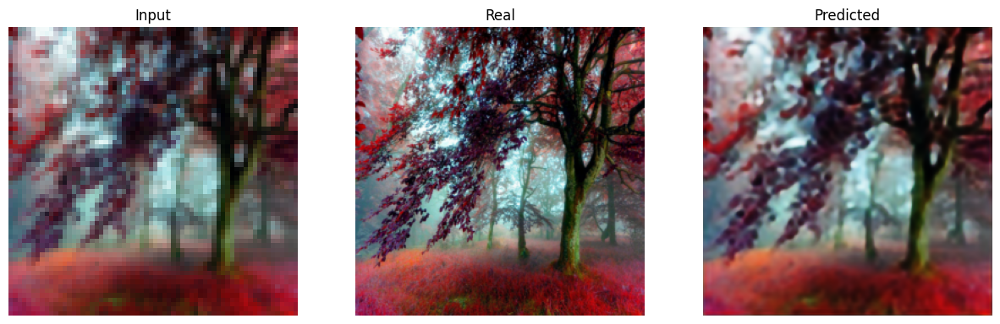

-----------------------------------------------------------
| End of epoch  45 | Time: 41.85s | Train psnr   24.991 | Train Loss    0.069 | Valid psnr   25.042 | Valid Loss    0.065 
-----------------------------------------------------------


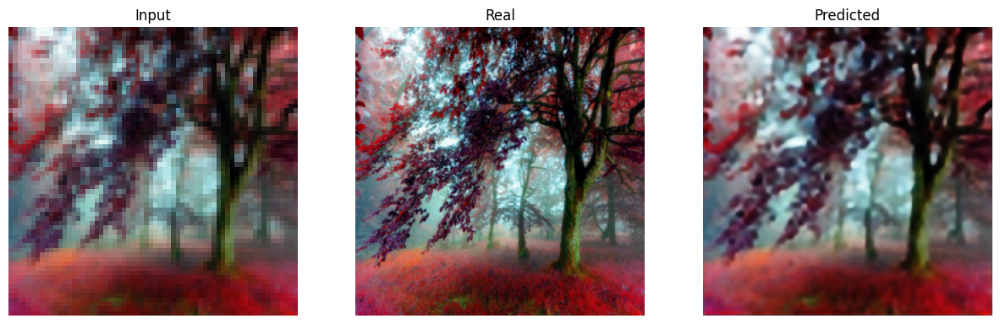

-----------------------------------------------------------
| End of epoch  46 | Time: 40.40s | Train psnr   24.914 | Train Loss    0.070 | Valid psnr   25.130 | Valid Loss    0.065 
-----------------------------------------------------------
-----------------------------------------------------------
| End of epoch  47 | Time: 38.98s | Train psnr   24.901 | Train Loss    0.070 | Valid psnr   25.095 | Valid Loss    0.066 
-----------------------------------------------------------
-----------------------------------------------------------
| End of epoch  48 | Time: 38.77s | Train psnr   24.931 | Train Loss    0.070 | Valid psnr   24.834 | Valid Loss    0.066 
-----------------------------------------------------------
-----------------------------------------------------------
| End of epoch  49 | Time: 39.65s | Train psnr   24.853 | Train Loss    0.072 | Valid psnr   24.595 | Valid Loss    0.075 
-----------------------------------------------------------
----------------------------

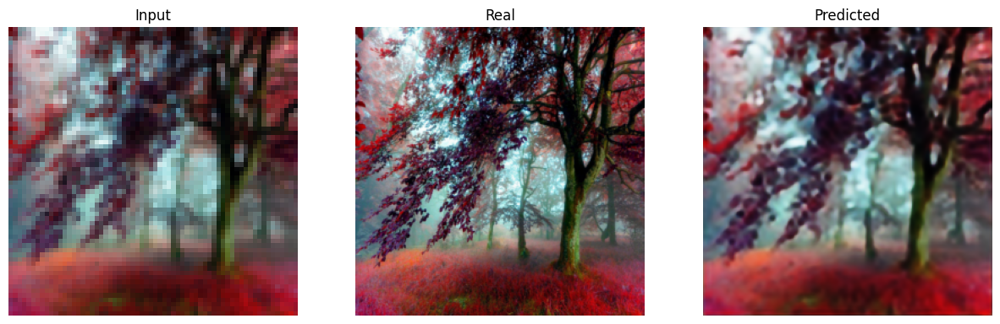

-----------------------------------------------------------
| End of epoch  56 | Time: 39.80s | Train psnr   25.008 | Train Loss    0.069 | Valid psnr   25.167 | Valid Loss    0.065 
-----------------------------------------------------------
-----------------------------------------------------------
| End of epoch  57 | Time: 39.76s | Train psnr   25.044 | Train Loss    0.068 | Valid psnr   25.095 | Valid Loss    0.066 
-----------------------------------------------------------
-----------------------------------------------------------
| End of epoch  58 | Time: 39.61s | Train psnr   24.926 | Train Loss    0.070 | Valid psnr   24.970 | Valid Loss    0.066 
-----------------------------------------------------------
-----------------------------------------------------------
| End of epoch  59 | Time: 39.77s | Train psnr   25.031 | Train Loss    0.069 | Valid psnr   25.155 | Valid Loss    0.066 
-----------------------------------------------------------
----------------------------

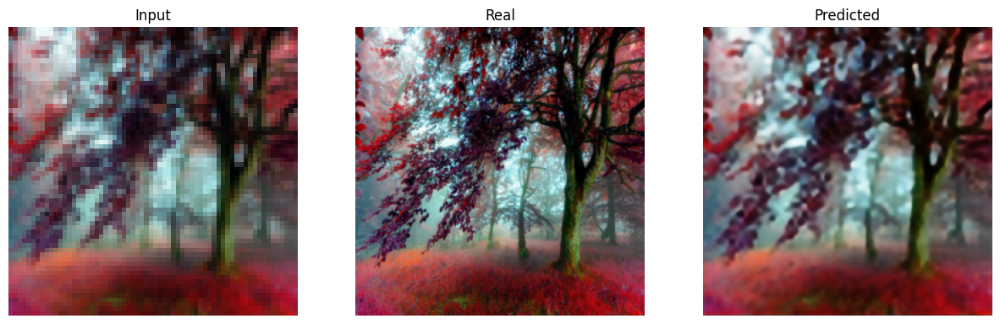

-----------------------------------------------------------
| End of epoch  61 | Time: 40.17s | Train psnr   25.071 | Train Loss    0.068 | Valid psnr   25.232 | Valid Loss    0.064 
-----------------------------------------------------------
-----------------------------------------------------------
| End of epoch  62 | Time: 40.10s | Train psnr   25.082 | Train Loss    0.068 | Valid psnr   25.101 | Valid Loss    0.066 
-----------------------------------------------------------
-----------------------------------------------------------
| End of epoch  63 | Time: 41.11s | Train psnr   25.068 | Train Loss    0.069 | Valid psnr   25.152 | Valid Loss    0.065 
-----------------------------------------------------------
-----------------------------------------------------------
| End of epoch  64 | Time: 39.96s | Train psnr   25.083 | Train Loss    0.068 | Valid psnr   25.121 | Valid Loss    0.066 
-----------------------------------------------------------
----------------------------

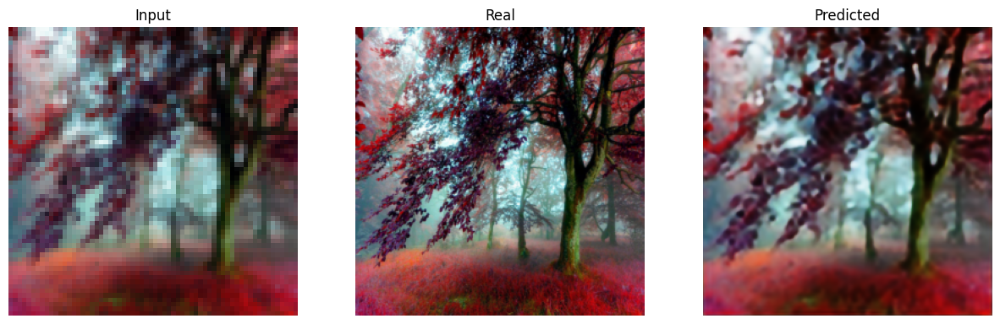

-----------------------------------------------------------
| End of epoch  69 | Time: 40.14s | Train psnr   25.095 | Train Loss    0.068 | Valid psnr   25.277 | Valid Loss    0.063 
-----------------------------------------------------------


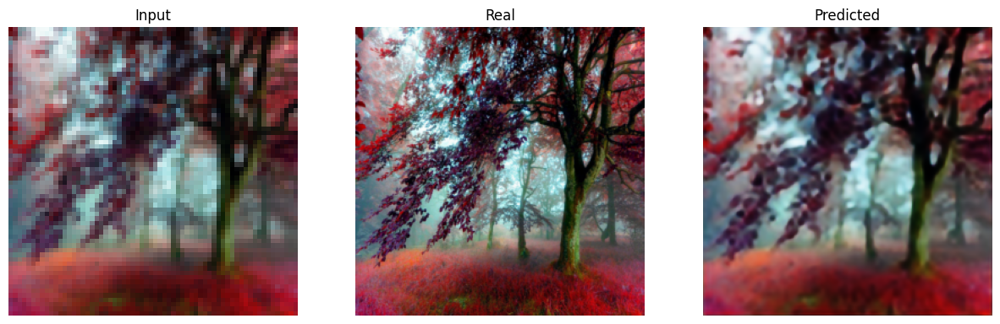

-----------------------------------------------------------
| End of epoch  70 | Time: 40.65s | Train psnr   25.210 | Train Loss    0.066 | Valid psnr   25.284 | Valid Loss    0.063 
-----------------------------------------------------------
-----------------------------------------------------------
| End of epoch  71 | Time: 40.16s | Train psnr   25.095 | Train Loss    0.069 | Valid psnr   24.984 | Valid Loss    0.066 
-----------------------------------------------------------
-----------------------------------------------------------
| End of epoch  72 | Time: 38.88s | Train psnr   25.275 | Train Loss    0.065 | Valid psnr   25.236 | Valid Loss    0.066 
-----------------------------------------------------------


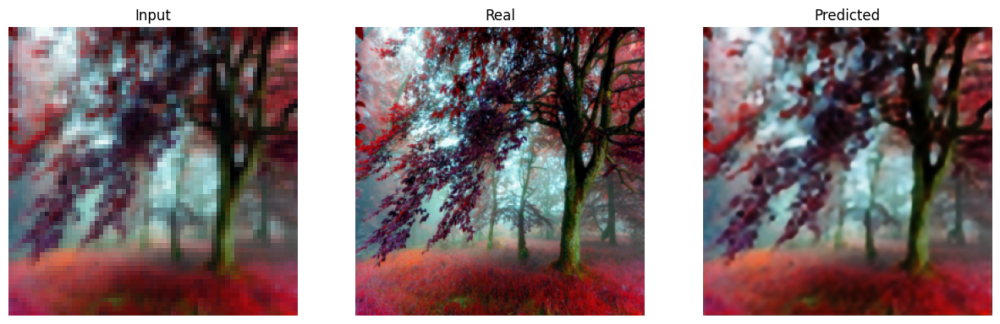

-----------------------------------------------------------
| End of epoch  73 | Time: 40.52s | Train psnr   25.182 | Train Loss    0.067 | Valid psnr   25.301 | Valid Loss    0.064 
-----------------------------------------------------------
-----------------------------------------------------------
| End of epoch  74 | Time: 40.01s | Train psnr   25.143 | Train Loss    0.068 | Valid psnr   25.272 | Valid Loss    0.063 
-----------------------------------------------------------
-----------------------------------------------------------
| End of epoch  75 | Time: 38.59s | Train psnr   25.166 | Train Loss    0.068 | Valid psnr   25.224 | Valid Loss    0.064 
-----------------------------------------------------------
-----------------------------------------------------------
| End of epoch  76 | Time: 39.49s | Train psnr   25.187 | Train Loss    0.067 | Valid psnr   24.821 | Valid Loss    0.069 
-----------------------------------------------------------
----------------------------

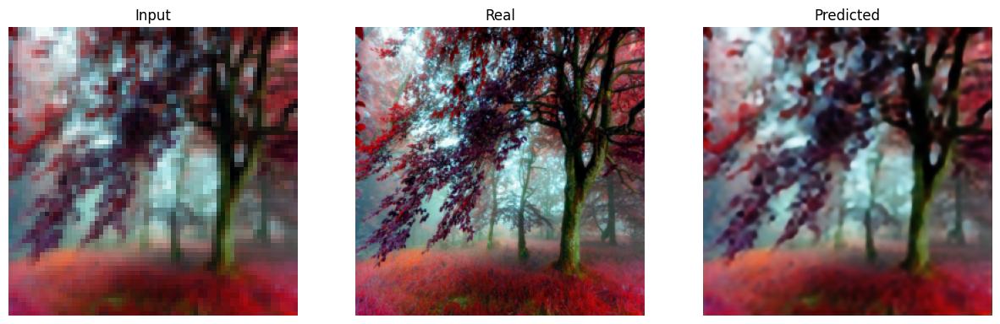

-----------------------------------------------------------
| End of epoch  78 | Time: 40.50s | Train psnr   25.100 | Train Loss    0.069 | Valid psnr   25.329 | Valid Loss    0.063 
-----------------------------------------------------------
-----------------------------------------------------------
| End of epoch  79 | Time: 39.19s | Train psnr   25.172 | Train Loss    0.067 | Valid psnr   25.269 | Valid Loss    0.065 
-----------------------------------------------------------
-----------------------------------------------------------
| End of epoch  80 | Time: 39.99s | Train psnr   25.239 | Train Loss    0.066 | Valid psnr   25.172 | Valid Loss    0.067 
-----------------------------------------------------------
-----------------------------------------------------------
| End of epoch  81 | Time: 41.10s | Train psnr   25.333 | Train Loss    0.065 | Valid psnr   25.027 | Valid Loss    0.067 
-----------------------------------------------------------


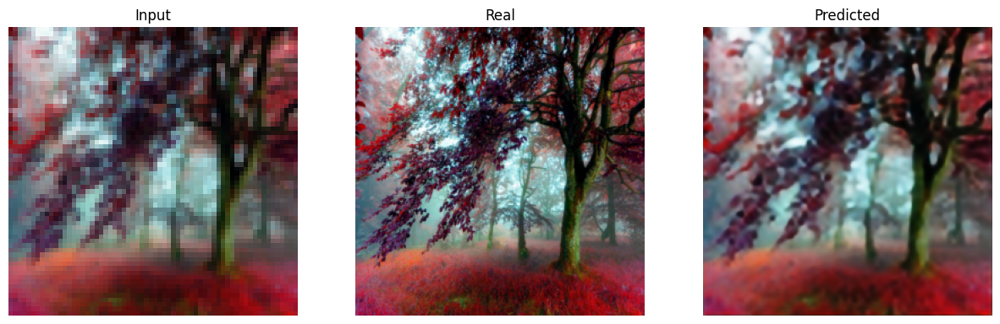

-----------------------------------------------------------
| End of epoch  82 | Time: 41.43s | Train psnr   25.341 | Train Loss    0.065 | Valid psnr   25.352 | Valid Loss    0.063 
-----------------------------------------------------------
-----------------------------------------------------------
| End of epoch  83 | Time: 40.44s | Train psnr   25.210 | Train Loss    0.068 | Valid psnr   24.656 | Valid Loss    0.076 
-----------------------------------------------------------


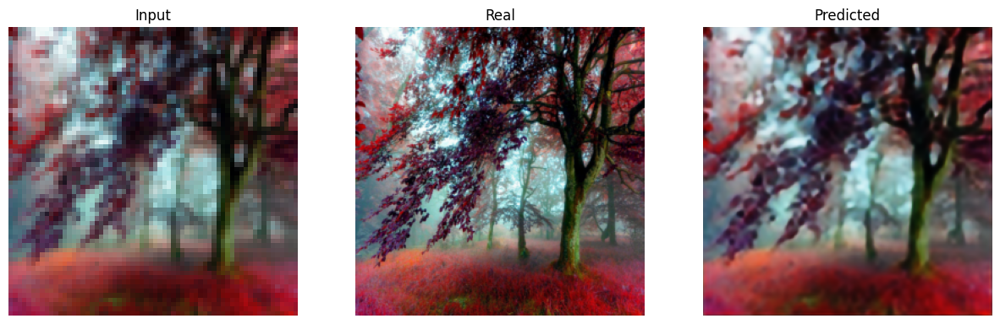

-----------------------------------------------------------
| End of epoch  84 | Time: 41.90s | Train psnr   25.326 | Train Loss    0.065 | Valid psnr   25.372 | Valid Loss    0.063 
-----------------------------------------------------------


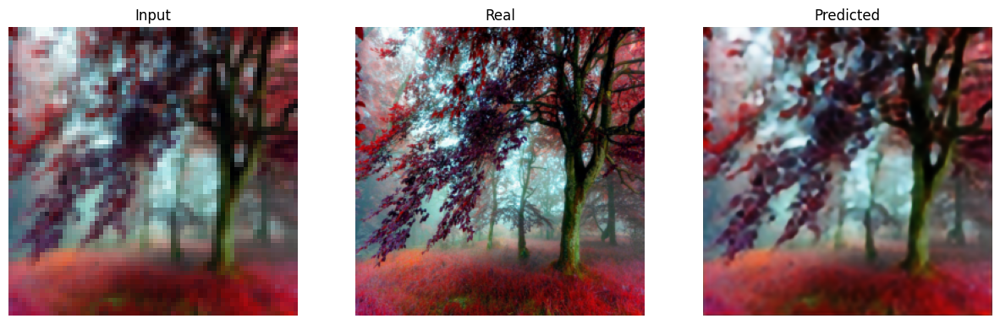

-----------------------------------------------------------
| End of epoch  85 | Time: 42.19s | Train psnr   25.348 | Train Loss    0.065 | Valid psnr   25.413 | Valid Loss    0.061 
-----------------------------------------------------------
-----------------------------------------------------------
| End of epoch  86 | Time: 39.27s | Train psnr   25.347 | Train Loss    0.065 | Valid psnr   25.226 | Valid Loss    0.067 
-----------------------------------------------------------
-----------------------------------------------------------
| End of epoch  87 | Time: 38.88s | Train psnr   25.310 | Train Loss    0.066 | Valid psnr   25.191 | Valid Loss    0.064 
-----------------------------------------------------------
-----------------------------------------------------------
| End of epoch  88 | Time: 41.27s | Train psnr   25.263 | Train Loss    0.067 | Valid psnr    6.596 | Valid Loss    0.725 
-----------------------------------------------------------
----------------------------

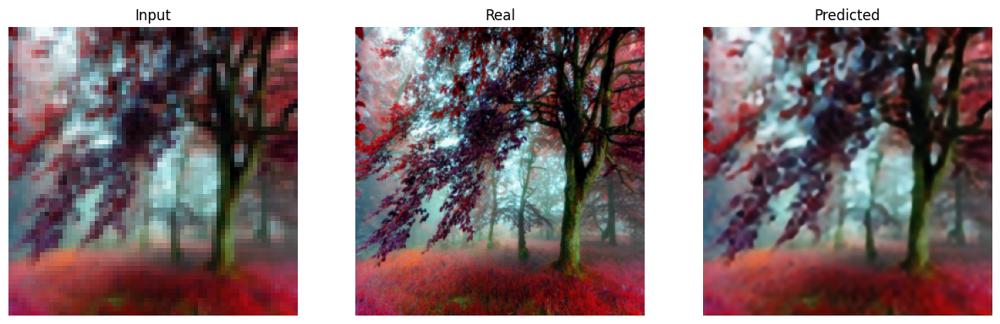

-----------------------------------------------------------
| End of epoch  94 | Time: 41.58s | Train psnr   25.359 | Train Loss    0.065 | Valid psnr   25.447 | Valid Loss    0.062 
-----------------------------------------------------------
-----------------------------------------------------------
| End of epoch  95 | Time: 40.22s | Train psnr   25.308 | Train Loss    0.066 | Valid psnr   25.366 | Valid Loss    0.064 
-----------------------------------------------------------
-----------------------------------------------------------
| End of epoch  96 | Time: 39.98s | Train psnr   25.376 | Train Loss    0.065 | Valid psnr   25.090 | Valid Loss    0.070 
-----------------------------------------------------------
-----------------------------------------------------------
| End of epoch  97 | Time: 40.30s | Train psnr   25.239 | Train Loss    0.066 | Valid psnr   25.378 | Valid Loss    0.064 
-----------------------------------------------------------
----------------------------

In [ ]:
import torch.optim as optim

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
SR_unet_model = SR_Unet().to(device)
SR_unet_model.to(device)

criterion = nn.L1Loss()

optimizer = optim.Adam(SR_unet_model.parameters(), lr=1e-4, betas=[0.5,0.999])

save_model = './UNET'
os.makedirs(save_model, exist_ok = True)

EPOCHS = 100
SR_unet_model, metrics = train(
    SR_unet_model, 'SR_unet_model', save_model, optimizer, criterion, train_loader, test_loader, EPOCHS, device
)

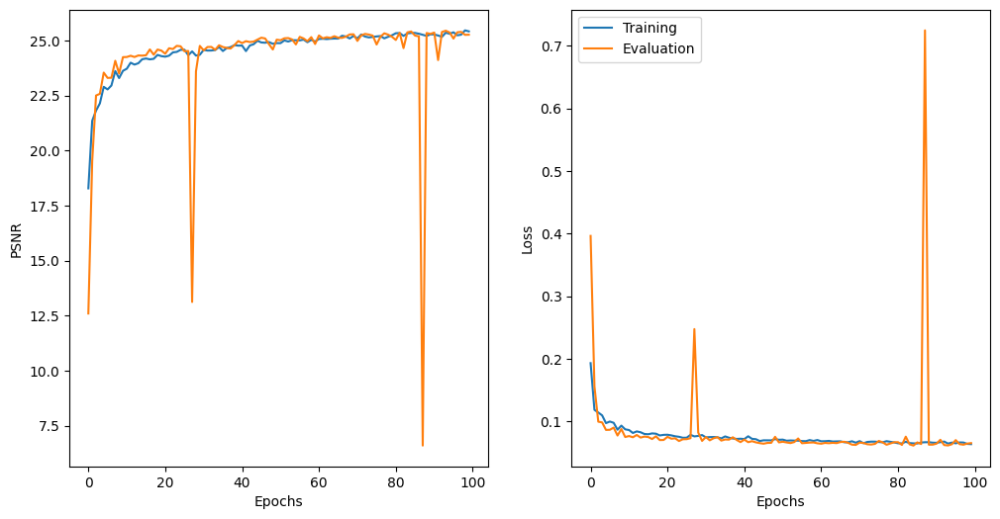

In [ ]:
plot_result(
    EPOCHS,
    metrics["train_psnr"],
    metrics["valid_psnr"],
    metrics["train_loss"],
    metrics["valid_loss"]
)

In [ ]:
test_psnr, test_loss = evaluate_epoch(SR_unet_model, criterion, test_loader, device)
test_psnr, test_loss

(tensor(25.4475, device='cuda:0'), 0.061691284800569214)

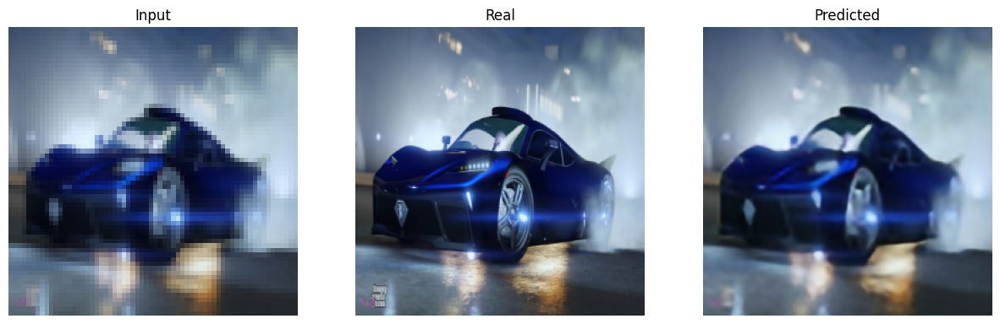

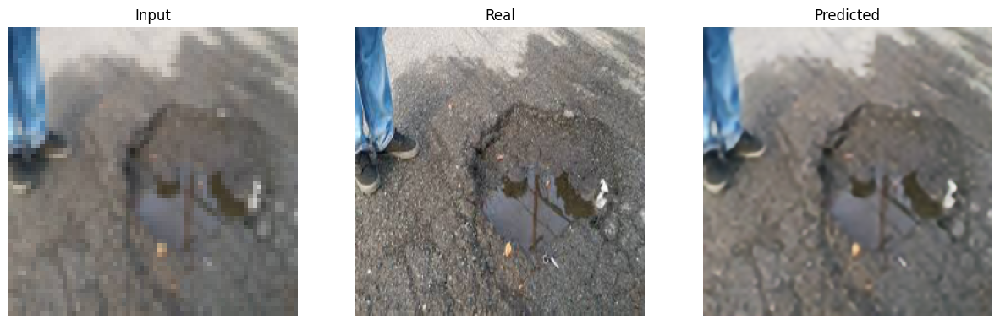

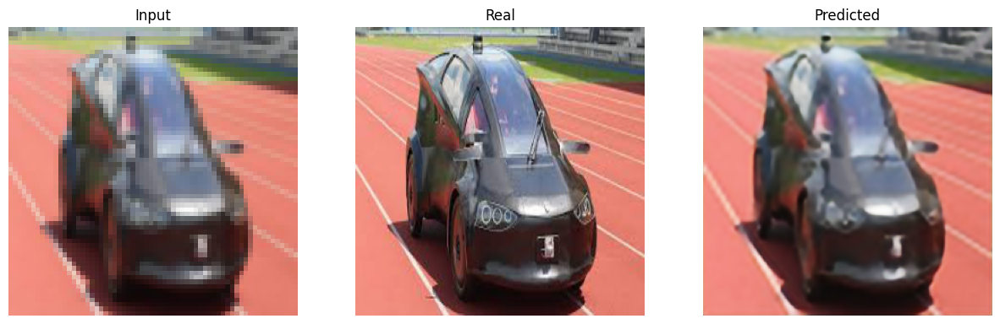

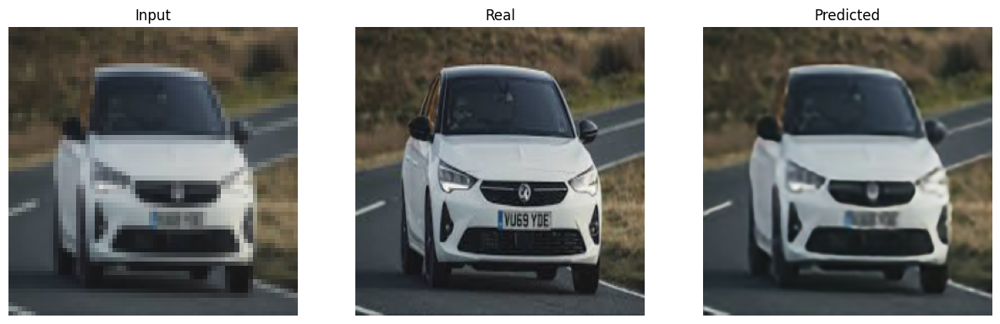

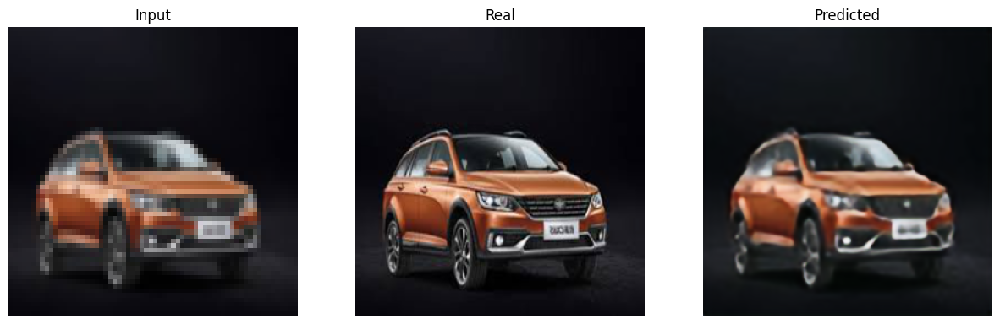

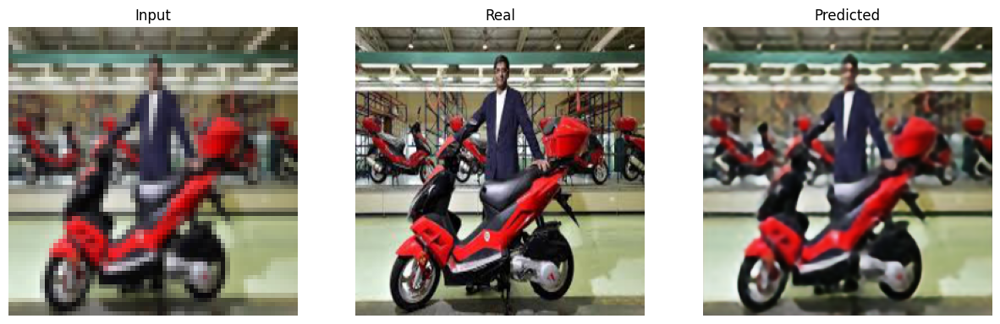

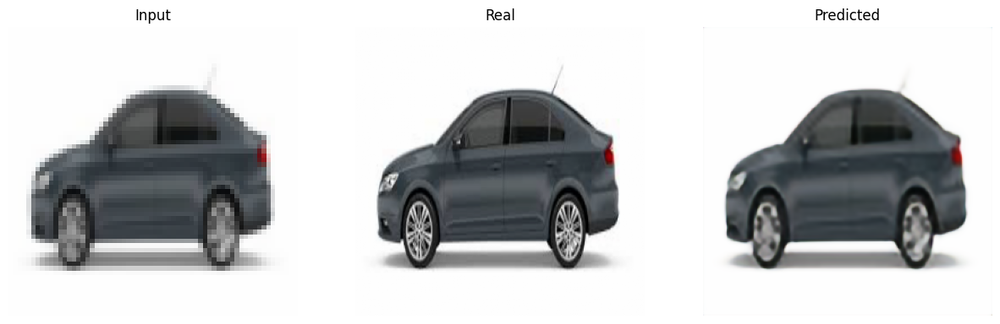

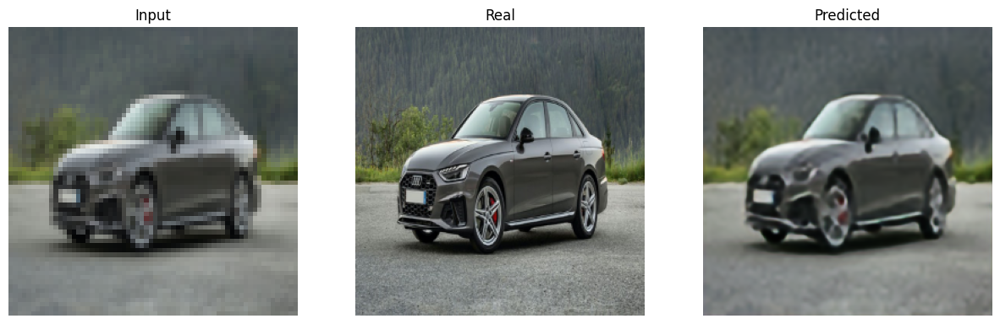

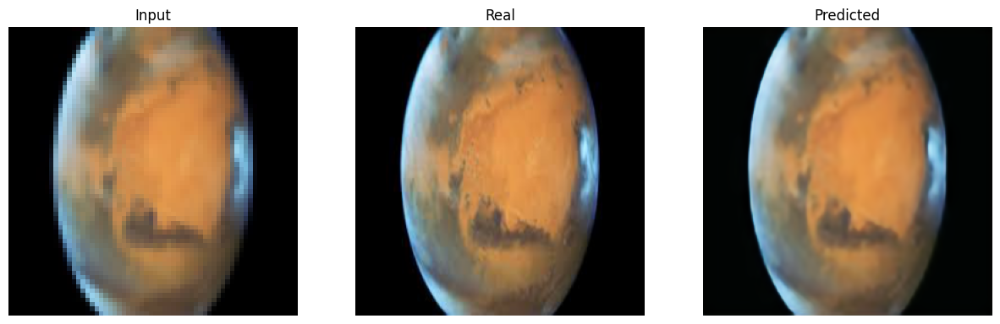

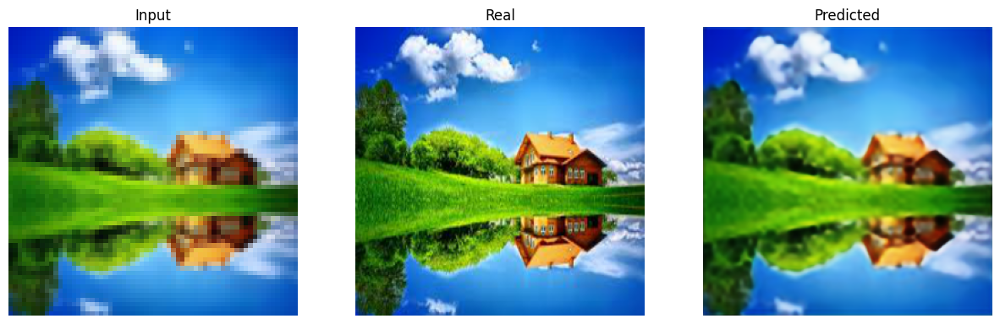

In [ ]:
predict_and_display(SR_unet_model, train_loader, device)

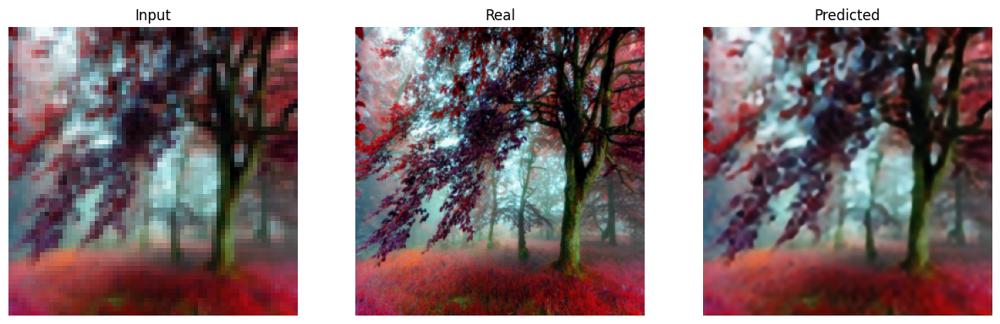

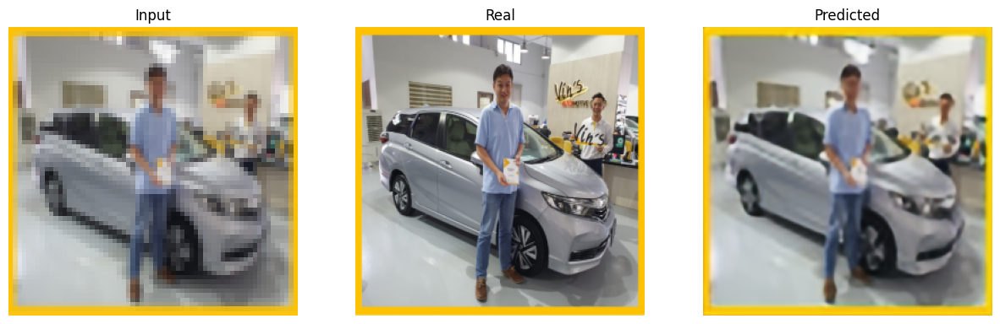

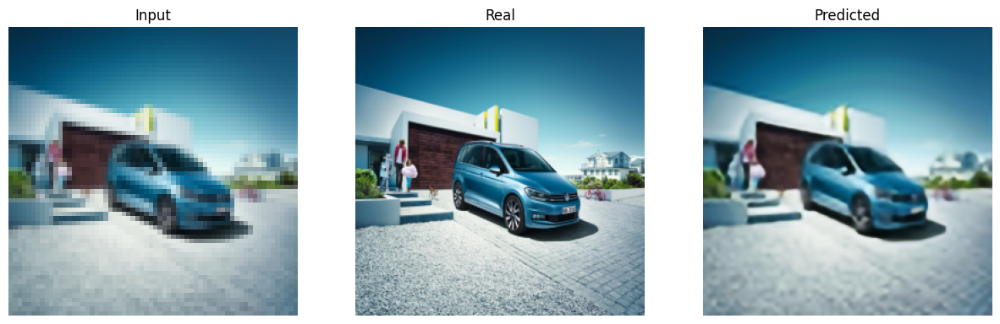

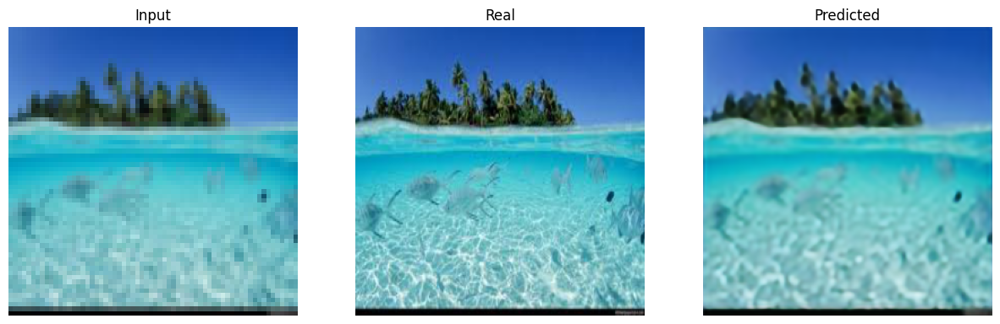

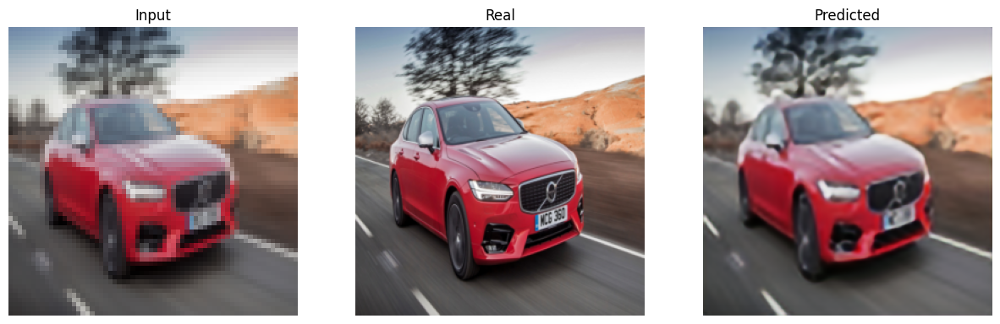

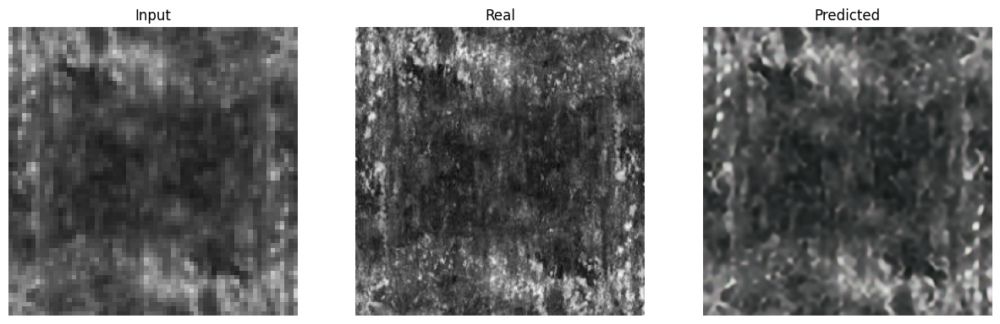

In [ ]:
predict_and_display(SR_unet_model, test_loader, device)